In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

%matplotlib inline


bif_c = 0.2
num_iter_max=200000


# alpha=0.1
# alpha=0.2
alpha=0.3
# alpha=0.5


# alpha=0.8 # predict diverge
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'
figfilenamehead = "fig_policy_evaluation_"

loss_list = []
normalized_loss_list = []

In [2]:
import gym
import custom_gym
env = gym.make(env_name)

seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



c = 0.21455680991172585
2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [4]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
             "bamdp_policy":None,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt


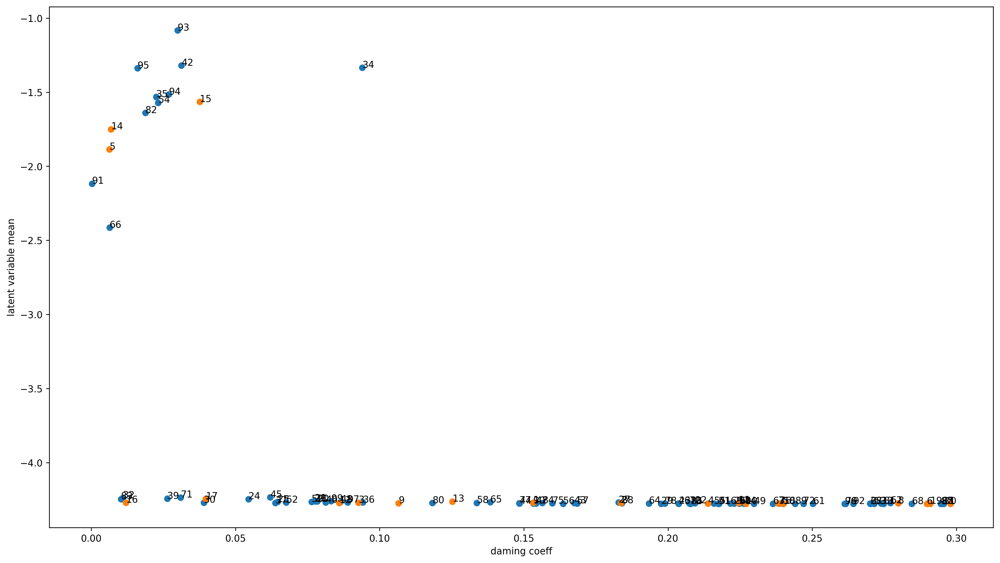

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_iter0.eps")
plt.savefig(figfilenamehead+"damping_latent_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  c = 0.16346495489906906
1  c = 0.175923049855898


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

2  c = 0.213101048692264
3  c = 0.14501806056071762
4  c = 0.004052611988015664
5  c = 0.120134560420777
6  c = 0.25697024030079035
7  c = 0.09642657758269942
8  c = 0.05526129195564814
9  c = 0.11417486037608537
10  c = 0.25864988011260814
11  c = 0.020876132555705383
12  c = 0.2613891486606151
13  c = 0.10624180953664825
14  c = 0.03203027777652895
15  c = 0.1622476552961531
16  c = 0.1618277342655034
17  c = 0.055320312028603325
18  c = 0.09391364165595244
19  c = 0.11885913261799258
20  c = 0.11403897859981632
21  c = 0.09912067121474619
22  c = 0.06488189030041151
23  c = 0.03506631058301788
24  c = 0.19965083813641546
25  c = 0.08571604451747712
26  c = 0.1514796791677473
27  c = 0.04546713757372708
28  c = 0.13733918450179566
29  c = 0.1522597624567635
30  c = 0.02389789952996266
31  c = 0.0638122346167221
32  c = 0.28146488121321594
33  c = 0.2259386184773079
34  c = 0.28977259206899
35  c = 0.15402135084365112
36  c = 0.14479756250669107
37  c = 0.013467426965231165
38  c = 0.

In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  c = 0.20021770810986864
1  c = 0.1983582812192558
2  c = 0.022555950291700478
3  c = 0.20541677419620874
4  c = 0.10100278390403257
5  c = 0.18626578567738697
6  c = 0.05051976271514567
7  c = 0.047219332290270255
8  c = 0.1703964189334006
9  c = 0.14840815680292022
10  c = 0.24494872822400177
11  c = 0.025342155733352467
12  c = 0.29120495159551035
13  c = 0.1062823595846313
14  c = 0.2005682341251094
15  c = 0.2575002131665844
16  c = 0.2478069086585581
17  c = 0.10556652164894924
18  c = 0.1263102409001565
19  c = 0.06421935796424785
20  c = 0.162199131307732
21  c = 0.2946662208960819
22  c = 0.07020726813281049
23  c = 0.15752760672287627
24  c = 0.08439030047625135
25  c = 0.07330712053657978
26  c = 0.1016651025954488
27  c = 0.006908891882512702
28  c = 0.1901597193331265
29  c = 0.1863173542495256
30  c = 0.15759887301895484
31  c = 0.0308689768266279
32  c = 0.24135050248338633
33  c = 0.2181328493603175
34  c = 0.10463073088503207
35  c = 0.04975650100345974
36  c = 0.179

93  c = 0.24488695696379334
94  c = 0.2531630725144382
95  c = 0.2501007404391354
predict diverge [ 10.74036884 774.70859349]
96  c = 0.03765543221993569
97  c = 0.1447889054074812
98  c = 0.03610528656962901
99  c = 0.2376621125429203
 
実環境方策rollout vs Sim環境方策rollout


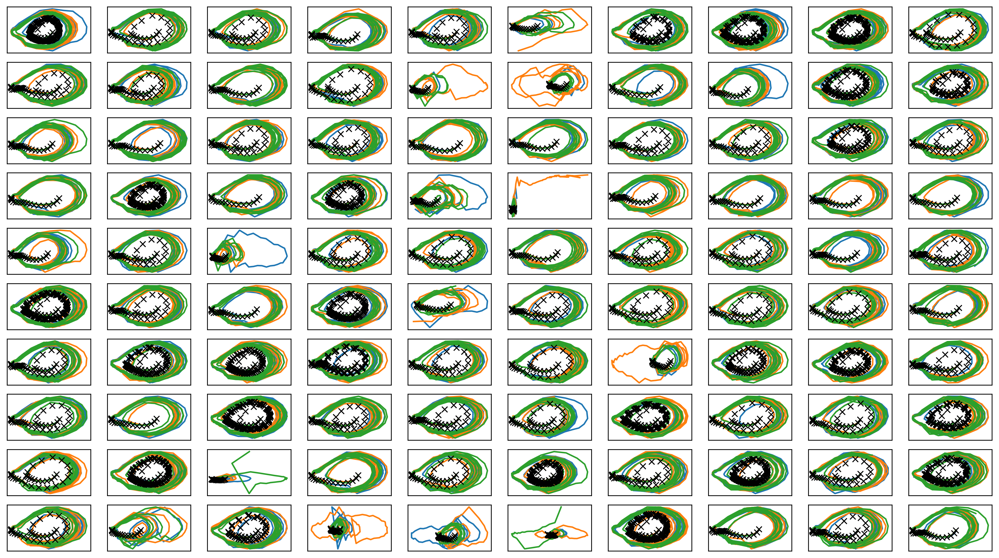

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter0.png")
plt.savefig(figfilenamehead+"joint_iter0.eps")
plt.savefig(figfilenamehead+"joint_iter0.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-04-04 02:00:34.359119


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.21173578446774205
c = 0.29613616116266267
c = 0.14261381247187307
c = 0.03134266417929309
c = 0.18768298619818488
c = 0.22746078515527657
c = 0.008477972314120097
1  c = 0.13479512447911798
c = 0.06128484916266449
c = 0.05153926393648715
c = 0.014095977336605158
c = 0.18640047639474708
c = 0.06696579973468546
c = 0.07418226119295034
c = 0.09801626505407315
c = 0.18738733329715648
2  c = 0.27552350639993944
c = 0.08638976355194454
c = 0.28650721828062853
c = 0.16757616581017884
c = 0.036303648522769905
c = 0.01886908811769725
c = 0.054504068698648656
c = 0.048511950143705636
c = 0.20357742157999598
c = 0.10243203801547246
c = 0.2009294802726103
c = 0.03233228597029623
3  c = 0.21626150878014552
c = 0.29526741876491275
c = 0.06555089226877321
c = 0.032139462474833076
c = 0.014239526318916906
c = 0.030234364519274526
c = 0.06154806697686888
4  c = 0.13527723677806278
c = 0.17707470996570454
c = 0.16786738404595006
c = 0.2476335009210234
c = 0.04045709864191702
c = 0.2238645530952

c = 0.28029962292362426
39  c = 0.017552532603062696
c = 0.06880490477533516
c = 0.03636056027400455
c = 0.016740400240395147
c = 0.20328694319617366
c = 0.08732037994367649
c = 0.10160571740539676
c = 0.06244627098091553
c = 0.1607209741667111
c = 0.1673849010506581
c = 0.2547219131447462
c = 0.10949415099267686
40  c = 0.1438521778683718
c = 0.11683210178109851
c = 0.07363771733319534
c = 0.03502177363594132
c = 0.24164893644104615
c = 0.17990015746807014
c = 0.24630547771384065
c = 0.0793861288033493
c = 0.28167872419885537
41  c = 0.2842304703941272
c = 0.2453951911476671
c = 0.10380060900923867
c = 0.2917185138651958
c = 0.16991292318500875
c = 0.02388665906696481
c = 0.05869218720214346
c = 0.10752058174220852
c = 0.23570631462068609
c = 0.16870487119724586
c = 0.09648756250162162
c = 0.2294975425219668
c = 0.18106195108554904
c = 0.059564674381799465
c = 0.029802557763132842
42  c = 0.11323842452961597
c = 0.20464121823317646
c = 0.18527363734244442
c = 0.07414279654095757
43  c

76  c = 0.2518869850810772
c = 0.0067099979865313355
c = 0.03663865137166565
c = 0.1471720822141774
c = 0.12929540079698054
c = 0.23082251192246242
c = 0.0876400526682163
77  c = 0.21375367840521042
c = 0.18405974814048967
c = 0.10988467442475998
c = 0.18790349518310207
c = 0.08961451462666815
c = 0.2771888968951758
c = 0.2987503474678797
c = 0.03529722839723291
c = 0.2584529873719788
c = 0.0010379018920250616
c = 0.2805684681792523
c = 0.05237333121805956
c = 0.026822237455981533
78  c = 0.2388796244338437
c = 0.10626539922124115
c = 0.20555535694285587
c = 0.00840914382866954
c = 0.006229749680078322
c = 0.026163358819039185
c = 0.17932985562733983
c = 0.03667670675739197
c = 0.24513444614505234
c = 0.2357656808225332
c = 0.23095305291539642
c = 0.21483039836416198
79  c = 0.19536556427650756
c = 0.15837306569588475
c = 0.06678960150906656
c = 0.1043101331176575
c = 0.18149978032536104
c = 0.12911266702871554
c = 0.2522572516555469
c = 0.23274246198153117
c = 0.224512725676042
80  c 

In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.27994  validloss 1.38982±0.00000  bestvalidloss 1.38982  last_update 0
train: iter 1  trainloss 0.93706  validloss 1.11291±0.00000  bestvalidloss 1.11291  last_update 0
train: iter 2  trainloss 0.78581  validloss 0.83044±0.00000  bestvalidloss 0.83044  last_update 0
train: iter 3  trainloss 0.70251  validloss 0.73681±0.00000  bestvalidloss 0.73681  last_update 0
train: iter 4  trainloss 0.62746  validloss 0.65580±0.00000  bestvalidloss 0.65580  last_update 0
train: iter 5  trainloss 0.58656  validloss 0.61001±0.00000  bestvalidloss 0.61001  last_update 0
train: iter 6  trainloss 0.55625  validloss 0.57417±0.00000  bestvalidloss 0.57417  last_update 0
train: iter 7  trainloss 0.53436  validloss 0.54966±0.00000  bestvalidloss 0.54966  last_update 0
train: iter 8  trainloss 0.51788  validloss 0.54372±0.00000  bestvalidloss 0.54372  last_update 0
train: iter 9  trainloss 0.50064  validloss 0.51886±0.00000  bestvalidloss 0.51886  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.26387  validloss 0.29192±0.00000  bestvalidloss 0.28755  last_update 2
train: iter 85  trainloss 0.26443  validloss 0.29450±0.00000  bestvalidloss 0.28755  last_update 3
train: iter 86  trainloss 0.26433  validloss 0.28788±0.00000  bestvalidloss 0.28755  last_update 4
train: iter 87  trainloss 0.26054  validloss 0.29281±0.00000  bestvalidloss 0.28755  last_update 5
train: iter 88  trainloss 0.25978  validloss 0.30166±0.00000  bestvalidloss 0.28755  last_update 6
train: iter 89  trainloss 0.26027  validloss 0.29358±0.00000  bestvalidloss 0.28755  last_update 7
train: iter 90  trainloss 0.25858  validloss 0.29167±0.00000  bestvalidloss 0.28755  last_update 8
train: iter 91  trainloss 0.26101  validloss 0.28354±0.00000  bestvalidloss 0.28354  last_update 0
train: iter 92  trainloss 0.25964  validloss 0.29099±0.00000  bestvalidloss 0.28354  last_update 1
train: iter 93  trainloss 0.25788  validloss 0.28503±0.00000  bestvalidloss 0.28354  last_update 2
train: ite

train: iter 166  trainloss 0.23342  validloss 0.26921±0.00000  bestvalidloss 0.26707  last_update 1
train: iter 167  trainloss 0.23534  validloss 0.27495±0.00000  bestvalidloss 0.26707  last_update 2
train: iter 168  trainloss 0.23649  validloss 0.26804±0.00000  bestvalidloss 0.26707  last_update 3
train: iter 169  trainloss 0.23322  validloss 0.27733±0.00000  bestvalidloss 0.26707  last_update 4
train: iter 170  trainloss 0.23577  validloss 0.27660±0.00000  bestvalidloss 0.26707  last_update 5
train: iter 171  trainloss 0.23210  validloss 0.28115±0.00000  bestvalidloss 0.26707  last_update 6
train: iter 172  trainloss 0.23267  validloss 0.27098±0.00000  bestvalidloss 0.26707  last_update 7
train: iter 173  trainloss 0.23360  validloss 0.27993±0.00000  bestvalidloss 0.26707  last_update 8
train: iter 174  trainloss 0.23002  validloss 0.26829±0.00000  bestvalidloss 0.26707  last_update 9
train: iter 175  trainloss 0.23355  validloss 0.27635±0.00000  bestvalidloss 0.26707  last_update 10

train: iter 248  trainloss 0.21830  validloss 0.25604±0.00000  bestvalidloss 0.25528  last_update 6
train: iter 249  trainloss 0.21915  validloss 0.26471±0.00000  bestvalidloss 0.25528  last_update 7
train: iter 250  trainloss 0.21827  validloss 0.26288±0.00000  bestvalidloss 0.25528  last_update 8
train: iter 251  trainloss 0.21628  validloss 0.25462±0.00000  bestvalidloss 0.25462  last_update 0
train: iter 252  trainloss 0.21654  validloss 0.25609±0.00000  bestvalidloss 0.25462  last_update 1
train: iter 253  trainloss 0.21422  validloss 0.25560±0.00000  bestvalidloss 0.25462  last_update 2
train: iter 254  trainloss 0.21369  validloss 0.25691±0.00000  bestvalidloss 0.25462  last_update 3
train: iter 255  trainloss 0.21444  validloss 0.25495±0.00000  bestvalidloss 0.25462  last_update 4
train: iter 256  trainloss 0.21697  validloss 0.26311±0.00000  bestvalidloss 0.25462  last_update 5
train: iter 257  trainloss 0.21366  validloss 0.25597±0.00000  bestvalidloss 0.25462  last_update 6


train: iter 331  trainloss 0.20805  validloss 0.25676±0.00000  bestvalidloss 0.24838  last_update 9
train: iter 332  trainloss 0.20794  validloss 0.26098±0.00000  bestvalidloss 0.24838  last_update 10
train: iter 333  trainloss 0.20885  validloss 0.25424±0.00000  bestvalidloss 0.24838  last_update 11
train: iter 334  trainloss 0.20959  validloss 0.25347±0.00000  bestvalidloss 0.24838  last_update 12
train: iter 335  trainloss 0.20496  validloss 0.25422±0.00000  bestvalidloss 0.24838  last_update 13
train: iter 336  trainloss 0.20370  validloss 0.24747±0.00000  bestvalidloss 0.24747  last_update 0
train: iter 337  trainloss 0.20625  validloss 0.24823±0.00000  bestvalidloss 0.24747  last_update 1
train: iter 338  trainloss 0.21469  validloss 0.26785±0.00000  bestvalidloss 0.24747  last_update 2
train: iter 339  trainloss 0.20659  validloss 0.25407±0.00000  bestvalidloss 0.24747  last_update 3
train: iter 340  trainloss 0.20827  validloss 0.25498±0.00000  bestvalidloss 0.24747  last_updat

train: iter 414  trainloss 0.19866  validloss 0.24282±0.00000  bestvalidloss 0.24190  last_update 5
train: iter 415  trainloss 0.19968  validloss 0.24426±0.00000  bestvalidloss 0.24190  last_update 6
train: iter 416  trainloss 0.19636  validloss 0.24443±0.00000  bestvalidloss 0.24190  last_update 7
train: iter 417  trainloss 0.19927  validloss 0.24553±0.00000  bestvalidloss 0.24190  last_update 8
train: iter 418  trainloss 0.20159  validloss 0.24232±0.00000  bestvalidloss 0.24190  last_update 9
train: iter 419  trainloss 0.19926  validloss 0.24319±0.00000  bestvalidloss 0.24190  last_update 10
train: iter 420  trainloss 0.19928  validloss 0.24368±0.00000  bestvalidloss 0.24190  last_update 11
train: iter 421  trainloss 0.19725  validloss 0.24255±0.00000  bestvalidloss 0.24190  last_update 12
train: iter 422  trainloss 0.20391  validloss 0.24376±0.00000  bestvalidloss 0.24190  last_update 13
train: iter 423  trainloss 0.20092  validloss 0.24329±0.00000  bestvalidloss 0.24190  last_updat

train: iter 497  trainloss 0.19284  validloss 0.23987±0.00000  bestvalidloss 0.23915  last_update 4
train: iter 498  trainloss 0.19360  validloss 0.23959±0.00000  bestvalidloss 0.23915  last_update 5
train: iter 499  trainloss 0.19349  validloss 0.24805±0.00000  bestvalidloss 0.23915  last_update 6
train: iter 500  trainloss 0.19399  validloss 0.24192±0.00000  bestvalidloss 0.23915  last_update 7
train: iter 501  trainloss 0.19272  validloss 0.23882±0.00000  bestvalidloss 0.23882  last_update 0
train: iter 502  trainloss 0.19434  validloss 0.24070±0.00000  bestvalidloss 0.23882  last_update 1
train: iter 503  trainloss 0.19856  validloss 0.23838±0.00000  bestvalidloss 0.23838  last_update 0
train: iter 504  trainloss 0.19554  validloss 0.25049±0.00000  bestvalidloss 0.23838  last_update 1
train: iter 505  trainloss 0.19285  validloss 0.24551±0.00000  bestvalidloss 0.23838  last_update 2
train: iter 506  trainloss 0.19693  validloss 0.23999±0.00000  bestvalidloss 0.23838  last_update 3


train: iter 579  trainloss 0.18885  validloss 0.24445±0.00000  bestvalidloss 0.23674  last_update 2
train: iter 580  trainloss 0.19010  validloss 0.24082±0.00000  bestvalidloss 0.23674  last_update 3
train: iter 581  trainloss 0.19203  validloss 0.23576±0.00000  bestvalidloss 0.23576  last_update 0
train: iter 582  trainloss 0.18808  validloss 0.23851±0.00000  bestvalidloss 0.23576  last_update 1
train: iter 583  trainloss 0.19038  validloss 0.24981±0.00000  bestvalidloss 0.23576  last_update 2
train: iter 584  trainloss 0.18907  validloss 0.23850±0.00000  bestvalidloss 0.23576  last_update 3
train: iter 585  trainloss 0.18914  validloss 0.24045±0.00000  bestvalidloss 0.23576  last_update 4
train: iter 586  trainloss 0.18843  validloss 0.23971±0.00000  bestvalidloss 0.23576  last_update 5
train: iter 587  trainloss 0.19075  validloss 0.23725±0.00000  bestvalidloss 0.23576  last_update 6
train: iter 588  trainloss 0.19142  validloss 0.24056±0.00000  bestvalidloss 0.23576  last_update 7


train: iter 661  trainloss 0.18756  validloss 0.23556±0.00000  bestvalidloss 0.23381  last_update 3
train: iter 662  trainloss 0.18534  validloss 0.23757±0.00000  bestvalidloss 0.23381  last_update 4
train: iter 663  trainloss 0.18660  validloss 0.23793±0.00000  bestvalidloss 0.23381  last_update 5
train: iter 664  trainloss 0.18972  validloss 0.24263±0.00000  bestvalidloss 0.23381  last_update 6
train: iter 665  trainloss 0.18684  validloss 0.23556±0.00000  bestvalidloss 0.23381  last_update 7
train: iter 666  trainloss 0.18658  validloss 0.23999±0.00000  bestvalidloss 0.23381  last_update 8
train: iter 667  trainloss 0.18602  validloss 0.23810±0.00000  bestvalidloss 0.23381  last_update 9
train: iter 668  trainloss 0.18679  validloss 0.23657±0.00000  bestvalidloss 0.23381  last_update 10
train: iter 669  trainloss 0.18466  validloss 0.23976±0.00000  bestvalidloss 0.23381  last_update 11
train: iter 670  trainloss 0.18371  validloss 0.23697±0.00000  bestvalidloss 0.23381  last_update 

train: iter 744  trainloss 0.18235  validloss 0.23263±0.00000  bestvalidloss 0.23073  last_update 7
train: iter 745  trainloss 0.18151  validloss 0.23258±0.00000  bestvalidloss 0.23073  last_update 8
train: iter 746  trainloss 0.18502  validloss 0.23353±0.00000  bestvalidloss 0.23073  last_update 9
train: iter 747  trainloss 0.18156  validloss 0.23793±0.00000  bestvalidloss 0.23073  last_update 10
train: iter 748  trainloss 0.18341  validloss 0.23276±0.00000  bestvalidloss 0.23073  last_update 11
train: iter 749  trainloss 0.18160  validloss 0.23169±0.00000  bestvalidloss 0.23073  last_update 12
train: iter 750  trainloss 0.18087  validloss 0.23338±0.00000  bestvalidloss 0.23073  last_update 13
train: iter 751  trainloss 0.18118  validloss 0.23623±0.00000  bestvalidloss 0.23073  last_update 14
train: iter 752  trainloss 0.18212  validloss 0.23515±0.00000  bestvalidloss 0.23073  last_update 15
train: iter 753  trainloss 0.18518  validloss 0.23838±0.00000  bestvalidloss 0.23073  last_upd

train: iter 826  trainloss 0.17783  validloss 0.23081±0.00000  bestvalidloss 0.22921  last_update 5
train: iter 827  trainloss 0.17994  validloss 0.23074±0.00000  bestvalidloss 0.22921  last_update 6
train: iter 828  trainloss 0.17978  validloss 0.23541±0.00000  bestvalidloss 0.22921  last_update 7
train: iter 829  trainloss 0.17914  validloss 0.23050±0.00000  bestvalidloss 0.22921  last_update 8
train: iter 830  trainloss 0.17647  validloss 0.23352±0.00000  bestvalidloss 0.22921  last_update 9
train: iter 831  trainloss 0.18048  validloss 0.23009±0.00000  bestvalidloss 0.22921  last_update 10
train: iter 832  trainloss 0.17978  validloss 0.22928±0.00000  bestvalidloss 0.22921  last_update 11
train: iter 833  trainloss 0.18027  validloss 0.22925±0.00000  bestvalidloss 0.22921  last_update 12
train: iter 834  trainloss 0.17965  validloss 0.23269±0.00000  bestvalidloss 0.22921  last_update 13
train: iter 835  trainloss 0.18086  validloss 0.22941±0.00000  bestvalidloss 0.22921  last_updat

train: iter 908  trainloss 0.17462  validloss 0.23198±0.00000  bestvalidloss 0.22766  last_update 26
train: iter 909  trainloss 0.17515  validloss 0.22981±0.00000  bestvalidloss 0.22766  last_update 27
train: iter 910  trainloss 0.17543  validloss 0.22796±0.00000  bestvalidloss 0.22766  last_update 28
train: iter 911  trainloss 0.17488  validloss 0.22773±0.00000  bestvalidloss 0.22766  last_update 29
train: iter 912  trainloss 0.17493  validloss 0.23016±0.00000  bestvalidloss 0.22766  last_update 30
train: iter 913  trainloss 0.17609  validloss 0.23376±0.00000  bestvalidloss 0.22766  last_update 31
train: iter 914  trainloss 0.17493  validloss 0.23235±0.00000  bestvalidloss 0.22766  last_update 32
train: iter 915  trainloss 0.17575  validloss 0.23043±0.00000  bestvalidloss 0.22766  last_update 33
train: iter 916  trainloss 0.17534  validloss 0.22866±0.00000  bestvalidloss 0.22766  last_update 34
train: iter 917  trainloss 0.18064  validloss 0.25661±0.00000  bestvalidloss 0.22766  last_

train: iter 990  trainloss 0.17186  validloss 0.22690±0.00000  bestvalidloss 0.22635  last_update 11
train: iter 991  trainloss 0.17363  validloss 0.22761±0.00000  bestvalidloss 0.22635  last_update 12
train: iter 992  trainloss 0.17395  validloss 0.22862±0.00000  bestvalidloss 0.22635  last_update 13
train: iter 993  trainloss 0.17291  validloss 0.22687±0.00000  bestvalidloss 0.22635  last_update 14
train: iter 994  trainloss 0.17288  validloss 0.22876±0.00000  bestvalidloss 0.22635  last_update 15
train: iter 995  trainloss 0.17226  validloss 0.23497±0.00000  bestvalidloss 0.22635  last_update 16
train: iter 996  trainloss 0.17299  validloss 0.22655±0.00000  bestvalidloss 0.22635  last_update 17
train: iter 997  trainloss 0.17571  validloss 0.23113±0.00000  bestvalidloss 0.22635  last_update 18
train: iter 998  trainloss 0.17377  validloss 0.23461±0.00000  bestvalidloss 0.22635  last_update 19
train: iter 999  trainloss 0.17209  validloss 0.22835±0.00000  bestvalidloss 0.22635  last_

train: iter 1071  trainloss 0.17749  validloss 0.22885±0.00000  bestvalidloss 0.22532  last_update 27
train: iter 1072  trainloss 0.17225  validloss 0.22878±0.00000  bestvalidloss 0.22532  last_update 28
train: iter 1073  trainloss 0.17144  validloss 0.22700±0.00000  bestvalidloss 0.22532  last_update 29
train: iter 1074  trainloss 0.17049  validloss 0.22848±0.00000  bestvalidloss 0.22532  last_update 30
train: iter 1075  trainloss 0.17216  validloss 0.22597±0.00000  bestvalidloss 0.22532  last_update 31
train: iter 1076  trainloss 0.17076  validloss 0.22820±0.00000  bestvalidloss 0.22532  last_update 32
train: iter 1077  trainloss 0.17373  validloss 0.22732±0.00000  bestvalidloss 0.22532  last_update 33
train: iter 1078  trainloss 0.17396  validloss 0.23097±0.00000  bestvalidloss 0.22532  last_update 34
train: iter 1079  trainloss 0.17486  validloss 0.23632±0.00000  bestvalidloss 0.22532  last_update 35
train: iter 1080  trainloss 0.16978  validloss 0.22703±0.00000  bestvalidloss 0.22

train: iter 1153  trainloss 0.16834  validloss 0.22453±0.00000  bestvalidloss 0.22399  last_update 9
train: iter 1154  trainloss 0.16946  validloss 0.22500±0.00000  bestvalidloss 0.22399  last_update 10
train: iter 1155  trainloss 0.17054  validloss 0.22508±0.00000  bestvalidloss 0.22399  last_update 11
train: iter 1156  trainloss 0.16974  validloss 0.22616±0.00000  bestvalidloss 0.22399  last_update 12
train: iter 1157  trainloss 0.16937  validloss 0.22526±0.00000  bestvalidloss 0.22399  last_update 13
train: iter 1158  trainloss 0.17239  validloss 0.23499±0.00000  bestvalidloss 0.22399  last_update 14
train: iter 1159  trainloss 0.17081  validloss 0.23628±0.00000  bestvalidloss 0.22399  last_update 15
train: iter 1160  trainloss 0.17104  validloss 0.22421±0.00000  bestvalidloss 0.22399  last_update 16
train: iter 1161  trainloss 0.16761  validloss 0.22626±0.00000  bestvalidloss 0.22399  last_update 17
train: iter 1162  trainloss 0.16922  validloss 0.22889±0.00000  bestvalidloss 0.223

train: iter 1234  trainloss 0.16573  validloss 0.22773±0.00000  bestvalidloss 0.22344  last_update 35
train: iter 1235  trainloss 0.16553  validloss 0.22781±0.00000  bestvalidloss 0.22344  last_update 36
train: iter 1236  trainloss 0.17151  validloss 0.22575±0.00000  bestvalidloss 0.22344  last_update 37
train: iter 1237  trainloss 0.16742  validloss 0.22678±0.00000  bestvalidloss 0.22344  last_update 38
train: iter 1238  trainloss 0.16678  validloss 0.22531±0.00000  bestvalidloss 0.22344  last_update 39
train: iter 1239  trainloss 0.16627  validloss 0.22848±0.00000  bestvalidloss 0.22344  last_update 40
train: iter 1240  trainloss 0.16667  validloss 0.22526±0.00000  bestvalidloss 0.22344  last_update 41
train: iter 1241  trainloss 0.16572  validloss 0.22430±0.00000  bestvalidloss 0.22344  last_update 42
train: iter 1242  trainloss 0.16750  validloss 0.22663±0.00000  bestvalidloss 0.22344  last_update 43
train: iter 1243  trainloss 0.16491  validloss 0.22651±0.00000  bestvalidloss 0.22

In [12]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -150.55785709306602
valid_loss:  -231.48354434013368
train_loss:  -133.1798096328974
valid_loss:  -134.11299514770508


1e-08 1000.0


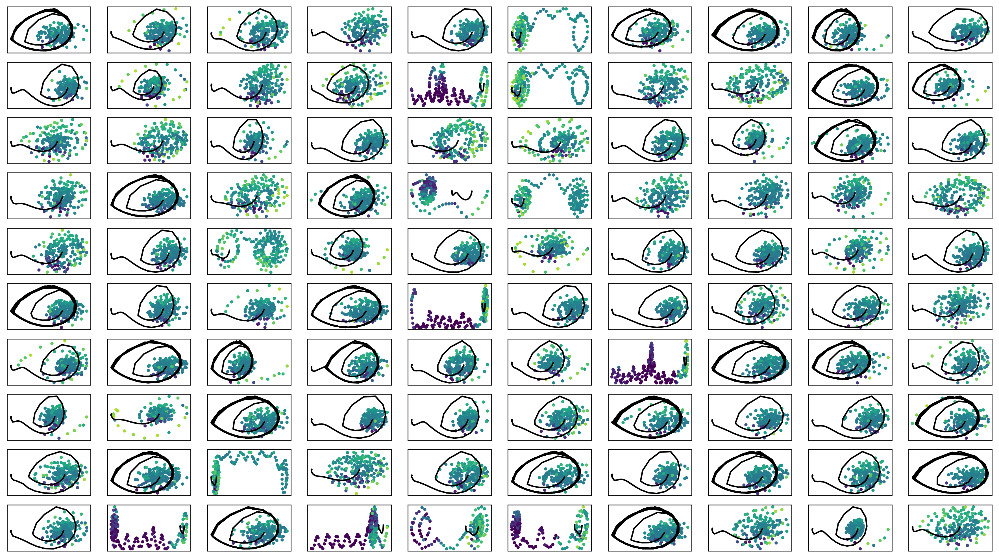

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -125.72280  validloss -134.32678±0.00000  bestvalidloss -134.32678  last_update 0
train: iter 1  trainloss -130.86109  validloss -131.99120±0.00000  bestvalidloss -134.32678  last_update 1
train: iter 2  trainloss -132.47854  validloss -112.06053±0.00000  bestvalidloss -134.32678  last_update 2
train: iter 3  trainloss -134.75392  validloss -119.60060±0.00000  bestvalidloss -134.32678  last_update 3
train: iter 4  trainloss -133.29061  validloss -119.00877±0.00000  bestvalidloss -134.32678  last_update 4
train: iter 5  trainloss -131.07691  validloss -107.69359±0.00000  bestvalidloss -134.32678  last_update 5
train: iter 6  trainloss -136.89279  validloss -112.30309±0.00000  bestvalidloss -134.32678  last_update 6
train: iter 7  trainloss -140.45773  validloss -104.54429±0.00000  bestvalidloss -134.32678  last_update 7
train: iter 8  trainloss -133.77101  validloss -101.87760±0.00000  bestvalidloss -134.32678  last_update 8
train: it

train: iter 77  trainloss -191.63503  validloss -178.43597±0.00000  bestvalidloss -189.33977  last_update 8
train: iter 78  trainloss -194.19144  validloss -168.82756±0.00000  bestvalidloss -189.33977  last_update 9
train: iter 79  trainloss -193.13297  validloss -172.67731±0.00000  bestvalidloss -189.33977  last_update 10
train: iter 80  trainloss -195.52989  validloss -188.17876±0.00000  bestvalidloss -189.33977  last_update 11
train: iter 81  trainloss -196.86493  validloss -187.84755±0.00000  bestvalidloss -189.33977  last_update 12
train: iter 82  trainloss -100.88935  validloss -145.93840±0.00000  bestvalidloss -189.33977  last_update 13
train: iter 83  trainloss -146.99000  validloss 124.11876±0.00000  bestvalidloss -189.33977  last_update 14
train: iter 84  trainloss -189.60920  validloss -174.50740±0.00000  bestvalidloss -189.33977  last_update 15
train: iter 85  trainloss -29.05559  validloss -156.91988±0.00000  bestvalidloss -189.33977  last_update 16
train: iter 86  trainlo

train: iter 154  trainloss -245.33904  validloss -229.61726±0.00000  bestvalidloss -248.18952  last_update 19
train: iter 155  trainloss -244.23875  validloss -230.88889±0.00000  bestvalidloss -248.18952  last_update 20
train: iter 156  trainloss -248.96302  validloss -242.42568±0.00000  bestvalidloss -248.18952  last_update 21
train: iter 157  trainloss -250.55393  validloss -242.93441±0.00000  bestvalidloss -248.18952  last_update 22
train: iter 158  trainloss -250.80680  validloss -247.35257±0.00000  bestvalidloss -248.18952  last_update 23
train: iter 159  trainloss -257.60277  validloss -243.55827±0.00000  bestvalidloss -248.18952  last_update 24
train: iter 160  trainloss -252.74912  validloss -248.96677±0.00000  bestvalidloss -248.96677  last_update 0
train: iter 161  trainloss -252.84784  validloss -237.29444±0.00000  bestvalidloss -248.96677  last_update 1
train: iter 162  trainloss -254.57592  validloss -241.31979±0.00000  bestvalidloss -248.96677  last_update 2
train: iter 1

train: iter 230  trainloss -257.43993  validloss -253.95384±0.00000  bestvalidloss -256.94753  last_update 7
train: iter 231  trainloss -256.87203  validloss -240.96071±0.00000  bestvalidloss -256.94753  last_update 8
train: iter 232  trainloss -258.88581  validloss -253.72061±0.00000  bestvalidloss -256.94753  last_update 9
train: iter 233  trainloss -251.27659  validloss -246.69433±0.00000  bestvalidloss -256.94753  last_update 10
train: iter 234  trainloss -253.95418  validloss -252.78190±0.00000  bestvalidloss -256.94753  last_update 11
train: iter 235  trainloss -257.70345  validloss -251.00317±0.00000  bestvalidloss -256.94753  last_update 12
train: iter 236  trainloss -257.73293  validloss -254.53252±0.00000  bestvalidloss -256.94753  last_update 13
train: iter 237  trainloss -258.70318  validloss -249.85040±0.00000  bestvalidloss -256.94753  last_update 14
train: iter 238  trainloss -260.68659  validloss -250.39149±0.00000  bestvalidloss -256.94753  last_update 15
train: iter 2

train: iter 306  trainloss -253.90465  validloss -227.64505±0.00000  bestvalidloss -256.94753  last_update 83
train: iter 307  trainloss -259.48950  validloss -248.89705±0.00000  bestvalidloss -256.94753  last_update 84
train: iter 308  trainloss -254.22061  validloss -240.06135±0.00000  bestvalidloss -256.94753  last_update 85
train: iter 309  trainloss -253.25138  validloss -248.23926±0.00000  bestvalidloss -256.94753  last_update 86
train: iter 310  trainloss -260.96084  validloss -245.74731±0.00000  bestvalidloss -256.94753  last_update 87
train: iter 311  trainloss -254.82018  validloss -247.99603±0.00000  bestvalidloss -256.94753  last_update 88
train: iter 312  trainloss -260.43479  validloss -247.34639±0.00000  bestvalidloss -256.94753  last_update 89
train: iter 313  trainloss -258.16799  validloss -250.20967±0.00000  bestvalidloss -256.94753  last_update 90
train: iter 314  trainloss -256.10209  validloss -245.69202±0.00000  bestvalidloss -256.94753  last_update 91
train: ite

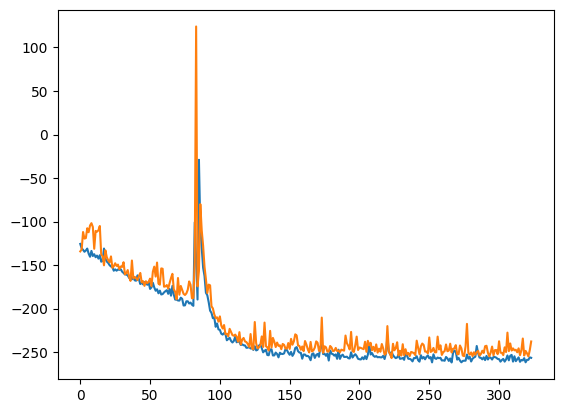

train_weighted_vae: enc
train: iter 0  trainloss -260.66123  validloss -251.99140±0.00000  bestvalidloss -251.99140  last_update 0
train: iter 1  trainloss -262.01269  validloss -246.73104±0.00000  bestvalidloss -251.99140  last_update 1
train: iter 2  trainloss -260.79165  validloss -248.28527±0.00000  bestvalidloss -251.99140  last_update 2
train: iter 3  trainloss -260.72513  validloss -251.67864±0.00000  bestvalidloss -251.99140  last_update 3
train: iter 4  trainloss -260.20646  validloss -248.84990±0.00000  bestvalidloss -251.99140  last_update 4
train: iter 5  trainloss -257.48565  validloss -252.99746±0.00000  bestvalidloss -252.99746  last_update 0
train: iter 6  trainloss -263.06474  validloss -251.74956±0.00000  bestvalidloss -252.99746  last_update 1
train: iter 7  trainloss -262.84146  validloss -250.92149±0.00000  bestvalidloss -252.99746  last_update 2
train: iter 8  trainloss -263.78345  validloss -250.68340±0.00000  bestvalidloss -252.99746  last_update 3
train: iter 9

train: iter 77  trainloss -262.37806  validloss -251.92868±0.00000  bestvalidloss -254.45288  last_update 67
train: iter 78  trainloss -263.98791  validloss -251.15995±0.00000  bestvalidloss -254.45288  last_update 68
train: iter 79  trainloss -264.64182  validloss -251.77765±0.00000  bestvalidloss -254.45288  last_update 69
train: iter 80  trainloss -263.34288  validloss -252.87347±0.00000  bestvalidloss -254.45288  last_update 70
train: iter 81  trainloss -262.19119  validloss -251.33866±0.00000  bestvalidloss -254.45288  last_update 71
train: iter 82  trainloss -263.39825  validloss -251.36130±0.00000  bestvalidloss -254.45288  last_update 72
train: iter 83  trainloss -263.11021  validloss -252.15674±0.00000  bestvalidloss -254.45288  last_update 73
train: iter 84  trainloss -261.79433  validloss -253.74469±0.00000  bestvalidloss -254.45288  last_update 74
train: iter 85  trainloss -263.47598  validloss -250.59852±0.00000  bestvalidloss -254.45288  last_update 75
train: iter 86  tra

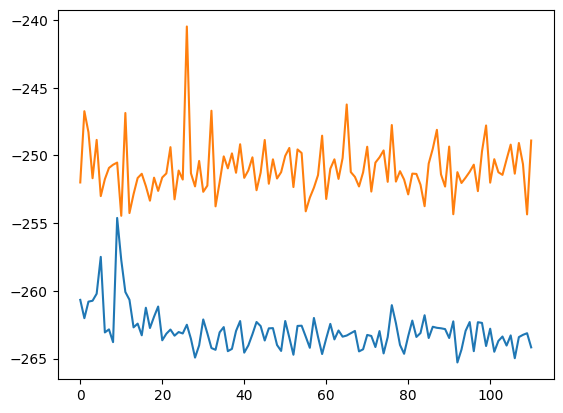

train_weighted_vae: dec
train: iter 0  trainloss -260.27584  validloss -253.28376±0.00000  bestvalidloss -253.28376  last_update 0
train: iter 1  trainloss -260.01643  validloss -247.53560±0.00000  bestvalidloss -253.28376  last_update 1
train: iter 2  trainloss -259.93845  validloss -252.44951±0.00000  bestvalidloss -253.28376  last_update 2
train: iter 3  trainloss -257.88857  validloss -250.97864±0.00000  bestvalidloss -253.28376  last_update 3
train: iter 4  trainloss -259.06800  validloss -253.67817±0.00000  bestvalidloss -253.67817  last_update 0
train: iter 5  trainloss -262.27975  validloss -249.82728±0.00000  bestvalidloss -253.67817  last_update 1
train: iter 6  trainloss -261.90574  validloss -255.40972±0.00000  bestvalidloss -255.40972  last_update 0
train: iter 7  trainloss -261.44266  validloss -254.50215±0.00000  bestvalidloss -255.40972  last_update 1
train: iter 8  trainloss -257.43554  validloss -249.03860±0.00000  bestvalidloss -255.40972  last_update 2
train: iter 9

train: iter 76  trainloss -262.37394  validloss -250.24965±0.00000  bestvalidloss -258.99574  last_update 41
train: iter 77  trainloss -259.28109  validloss -247.11460±0.00000  bestvalidloss -258.99574  last_update 42
train: iter 78  trainloss -263.24511  validloss -251.89701±0.00000  bestvalidloss -258.99574  last_update 43
train: iter 79  trainloss -263.60152  validloss -252.96469±0.00000  bestvalidloss -258.99574  last_update 44
train: iter 80  trainloss -262.03690  validloss -251.03294±0.00000  bestvalidloss -258.99574  last_update 45
train: iter 81  trainloss -260.06419  validloss -255.33851±0.00000  bestvalidloss -258.99574  last_update 46
train: iter 82  trainloss -258.41543  validloss -255.32302±0.00000  bestvalidloss -258.99574  last_update 47
train: iter 83  trainloss -258.78973  validloss -255.03128±0.00000  bestvalidloss -258.99574  last_update 48
train: iter 84  trainloss -261.70692  validloss -255.40883±0.00000  bestvalidloss -258.99574  last_update 49
train: iter 85  tra

train: iter 151  trainloss -261.87295  validloss -259.32482±0.00000  bestvalidloss -261.74495  last_update 50
train: iter 152  trainloss -259.75777  validloss -254.32152±0.00000  bestvalidloss -261.74495  last_update 51
train: iter 153  trainloss -266.31659  validloss -257.05501±0.00000  bestvalidloss -261.74495  last_update 52
train: iter 154  trainloss -263.81404  validloss -254.56845±0.00000  bestvalidloss -261.74495  last_update 53
train: iter 155  trainloss -264.00587  validloss -258.97218±0.00000  bestvalidloss -261.74495  last_update 54
train: iter 156  trainloss -262.98370  validloss -256.53058±0.00000  bestvalidloss -261.74495  last_update 55
train: iter 157  trainloss -262.70710  validloss -248.94790±0.00000  bestvalidloss -261.74495  last_update 56
train: iter 158  trainloss -257.16339  validloss -248.24454±0.00000  bestvalidloss -261.74495  last_update 57
train: iter 159  trainloss -257.57235  validloss -247.75625±0.00000  bestvalidloss -261.74495  last_update 58
train: ite

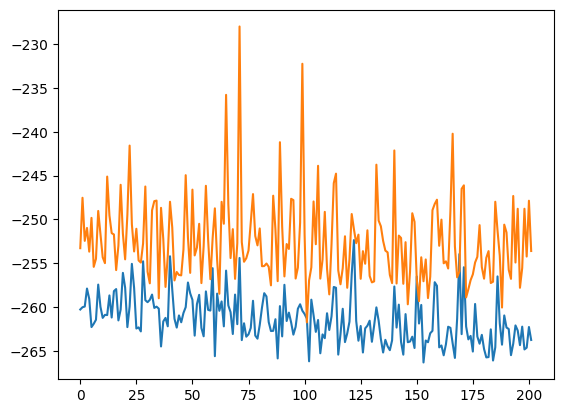

alpha 0.3 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.10780750544926214
1  c = 0.05361323702923205
2  c = 0.19764554837286233
3  c = 0.20246128209665962
4  c = 0.2107757711094295
5  c = 0.2314928041754737
6  c = 0.21635556291806676
7  c = 0.14681172432254921
8  c = 0.27550552673325857
9  c = 0.008092364228762305
10  c = 0.2666787732538002
11  c = 0.04432081026490795
12  c = 0.1491059702150909
13  c = 0.24674094083521114
14  c = 0.15764571970958927
15  c = 0.15532656906646228
16  c = 0.25811426790197894
17  c = 0.22144857277333524
18  c = 0.2222543209063424
19  c = 0.08960691618694173
20  c = 0.24437179205144263
21  c = 0.012123590701840792
22  c = 0.2225460714834801
23  c = 0.25153004796657985
24  c = 0.019667437919540308
25  c = 0.21289794961256786
26  c = 0.00025935195242183796
27  c = 0.08973875982870229
28  c = 0.13097149005832748
29  c = 0.10965987077869149
30  c = 0.0922328284662331
31  c = 0.05425354399680864
32  c = 0.15249989164190625
33  c = 0.07645793702711332
34  c = 0.10265718764957521
35  c = 0.17834730886221678
36 

95  c = 0.22705241659432404
96  c = 0.06521182909686735
97  c = 0.1129182816187404
98  c = 0.02720983536626226
99  c = 0.24884493950188355
 
実環境方策rollout vs Sim環境方策rollout


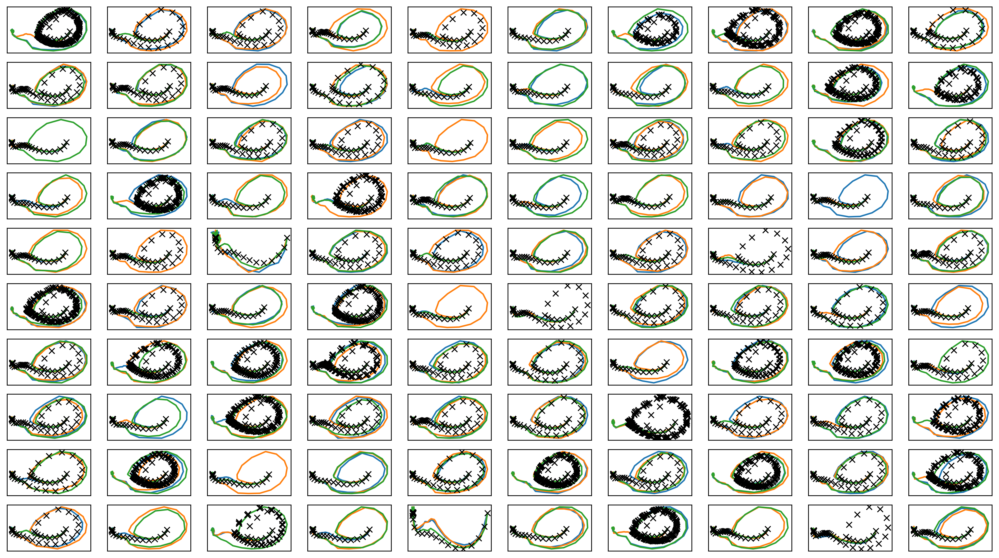

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter1.png")
plt.savefig(figfilenamehead+"joint_iter1.eps")
plt.savefig(figfilenamehead+"joint_iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

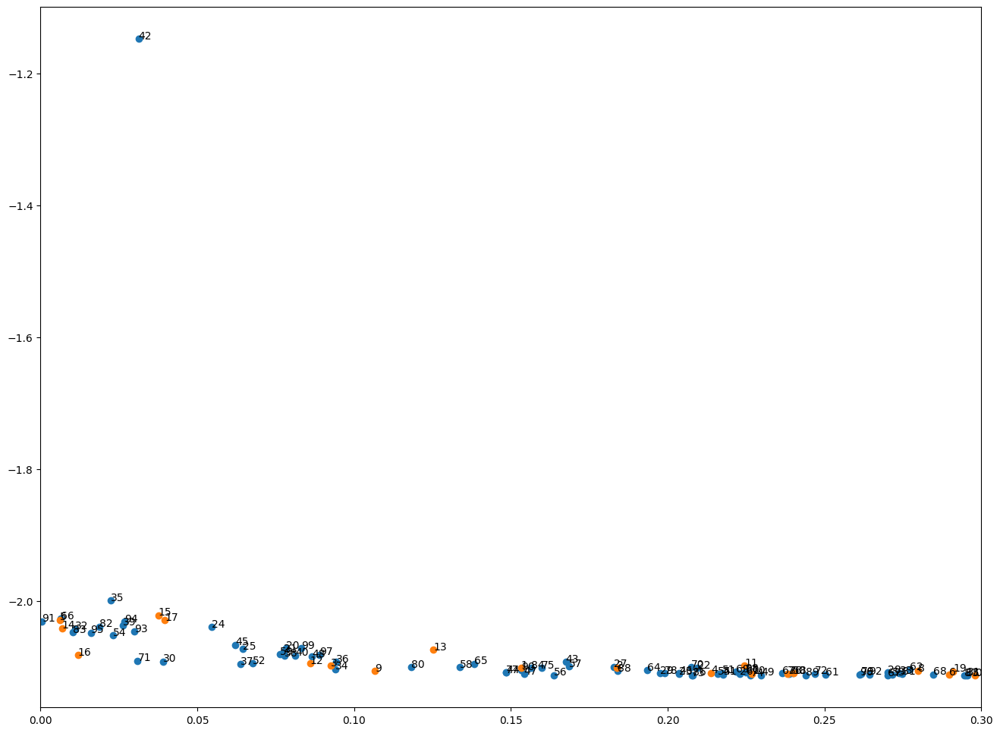

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-04-04 02:07:32.825150


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.017789121185744106
c = 0.15728493024358875
c = 0.20128857730578814
c = 0.23651613497639734
c = 0.013356600498728177
c = 0.2810008804477273
c = 0.1687080363093486
c = 0.056799511289809285
c = 0.07447560619211525
c = 0.22497114305496585
c = 0.14004370313887313
c = 0.16921599063242704
c = 0.0027244361930470417
c = 0.27260919259851757
c = 0.10690563914738363
1  c = 0.21911413004471123
c = 0.07886887903868657
c = 0.005971300632675103
c = 0.27183085816470665
2  c = 0.29958992997957096
c = 0.2398629688890358
c = 0.15519454625788334
c = 0.20816113361244196
c = 0.27337276571907954
c = 0.22158797992957263
3  c = 0.006987434735666309
c = 0.17530668203562488
c = 0.20990346306623167
c = 0.21569280547918301
c = 0.2639934893785429
c = 0.08464929107174227
4  c = 0.07138507255200867
c = 0.12514116583598944
c = 0.2657057806905572
c = 0.04406613557823589
c = 0.20020602382576488
c = 0.20177327205434253
c = 0.25859213756801963
c = 0.25960292079363617
c = 0.13961283560869103
c = 0.02061133489971476

c = 0.05742820838723486
c = 0.040733249643258196
40  c = 0.09261197115058797
c = 0.019597573791621636
c = 0.04447866789600632
c = 0.2367129724322132
c = 0.1485979623295579
c = 0.018204194908814274
c = 0.29226289846408426
c = 0.12127565030875094
c = 0.27375294133100975
c = 0.13269261914372246
41  c = 0.2049241158715802
c = 0.03253550793843752
c = 0.13422335244982597
c = 0.27714882641928335
c = 0.15023203068526633
c = 0.12903885878137267
42  c = 0.16020439925832436
c = 0.24007467897503382
c = 0.0329173324183437
c = 0.2145263194125776
c = 0.1396721410464431
c = 0.2494198488576726
c = 0.21404096340977471
c = 0.25408000776316175
43  c = 0.13872671036286513
c = 0.13271686561659682
c = 0.021967020834603668
c = 0.2596374628894148
c = 0.08342285372892756
c = 0.08548068892107
c = 0.19798878193477126
c = 0.17327950326249894
c = 0.18328180758456208
44  c = 0.1324853070976909
c = 0.13477598040923278
c = 0.08948055635238343
c = 0.24004111688689786
c = 0.00024299342293220282
c = 0.2663114866315298
c 

77  c = 0.13798840038756108
c = 0.19499760976064492
c = 0.04415091184576183
c = 0.05011385586612027
78  c = 0.24876990432620819
c = 0.27804158627855907
c = 0.15460740196396255
c = 0.24626380894916572
c = 0.08704602726570147
c = 0.037960689345891085
79  c = 0.25136611900366373
c = 0.2200146338271745
c = 0.15116250777015908
c = 0.22826367077952917
c = 0.21009663982804316
c = 0.14553196581851682
c = 0.2390158507118595
c = 0.2880242294526057
c = 0.08895379363933936
c = 0.07375723564005249
80  c = 0.20822839319762476
c = 0.26822210409066183
c = 0.2608341016019983
c = 0.01477042047049336
c = 0.1745542835979431
c = 0.2543036007510837
c = 0.2807644531523845
c = 0.2770901108398531
c = 0.19062194636673846
c = 0.09927164107798263
81  c = 0.13410946871246224
c = 0.1953121717101066
c = 0.2013896151335297
82  c = 0.2117959669506514
c = 0.24365884852411748
c = 0.22293266830393543
c = 0.0032608975467953603
c = 0.09176826669584205
c = 0.013283716234591224
c = 0.2794126838364988
83  c = 0.05116275728574

In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.17740  validloss 0.26590±0.00000  bestvalidloss 0.26590  last_update 0
train: iter 1  trainloss 0.16548  validloss 0.21101±0.00000  bestvalidloss 0.21101  last_update 0
train: iter 2  trainloss 0.16289  validloss 0.20643±0.00000  bestvalidloss 0.20643  last_update 0
train: iter 3  trainloss 0.16100  validloss 0.21370±0.00000  bestvalidloss 0.20643  last_update 1
train: iter 4  trainloss 0.15990  validloss 0.20329±0.00000  bestvalidloss 0.20329  last_update 0
train: iter 5  trainloss 0.15854  validloss 0.20024±0.00000  bestvalidloss 0.20024  last_update 0
train: iter 6  trainloss 0.15723  validloss 0.20533±0.00000  bestvalidloss 0.20024  last_update 1
train: iter 7  trainloss 0.15375  validloss 0.19703±0.00000  bestvalidloss 0.19703  last_update 0
train: iter 8  trainloss 0.15547  validloss 0.19454±0.00000  bestvalidloss 0.19454  last_update 0
train: iter 9  trainloss 0.15427  validloss 0.19491±0.00000  bestvalidloss 0.19454  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.13608  validloss 0.17253±0.00000  bestvalidloss 0.17036  last_update 2
train: iter 84  trainloss 0.13881  validloss 0.17037±0.00000  bestvalidloss 0.17036  last_update 3
train: iter 85  trainloss 0.13582  validloss 0.18856±0.00000  bestvalidloss 0.17036  last_update 4
train: iter 86  trainloss 0.13495  validloss 0.17311±0.00000  bestvalidloss 0.17036  last_update 5
train: iter 87  trainloss 0.13613  validloss 0.17381±0.00000  bestvalidloss 0.17036  last_update 6
train: iter 88  trainloss 0.13653  validloss 0.17262±0.00000  bestvalidloss 0.17036  last_update 7
train: iter 89  trainloss 0.13380  validloss 0.17324±0.00000  bestvalidloss 0.17036  last_update 8
train: iter 90  trainloss 0.13491  validloss 0.16869±0.00000  bestvalidloss 0.16869  last_update 0
train: iter 91  trainloss 0.13576  validloss 0.16943±0.00000  bestvalidloss 0.16869  last_update 1
train: iter 92  trainloss 0.13555  validloss 0.17015±0.00000  bestvalidloss 0.16869  last_update 2
train: ite

train: iter 165  trainloss 0.13044  validloss 0.16672±0.00000  bestvalidloss 0.16496  last_update 7
train: iter 166  trainloss 0.12947  validloss 0.16408±0.00000  bestvalidloss 0.16408  last_update 0
train: iter 167  trainloss 0.12974  validloss 0.16674±0.00000  bestvalidloss 0.16408  last_update 1
train: iter 168  trainloss 0.12916  validloss 0.16518±0.00000  bestvalidloss 0.16408  last_update 2
train: iter 169  trainloss 0.13147  validloss 0.16481±0.00000  bestvalidloss 0.16408  last_update 3
train: iter 170  trainloss 0.13165  validloss 0.16700±0.00000  bestvalidloss 0.16408  last_update 4
train: iter 171  trainloss 0.12944  validloss 0.16662±0.00000  bestvalidloss 0.16408  last_update 5
train: iter 172  trainloss 0.13091  validloss 0.16836±0.00000  bestvalidloss 0.16408  last_update 6
train: iter 173  trainloss 0.13043  validloss 0.16581±0.00000  bestvalidloss 0.16408  last_update 7
train: iter 174  trainloss 0.12987  validloss 0.16813±0.00000  bestvalidloss 0.16408  last_update 8


train: iter 247  trainloss 0.12985  validloss 0.16345±0.00000  bestvalidloss 0.16274  last_update 5
train: iter 248  trainloss 0.12688  validloss 0.16281±0.00000  bestvalidloss 0.16274  last_update 6
train: iter 249  trainloss 0.12672  validloss 0.16556±0.00000  bestvalidloss 0.16274  last_update 7
train: iter 250  trainloss 0.12732  validloss 0.16823±0.00000  bestvalidloss 0.16274  last_update 8
train: iter 251  trainloss 0.12720  validloss 0.16270±0.00000  bestvalidloss 0.16270  last_update 0
train: iter 252  trainloss 0.12679  validloss 0.16481±0.00000  bestvalidloss 0.16270  last_update 1
train: iter 253  trainloss 0.12681  validloss 0.16270±0.00000  bestvalidloss 0.16270  last_update 0
train: iter 254  trainloss 0.12645  validloss 0.16884±0.00000  bestvalidloss 0.16270  last_update 1
train: iter 255  trainloss 0.12717  validloss 0.16451±0.00000  bestvalidloss 0.16270  last_update 2
train: iter 256  trainloss 0.12743  validloss 0.17256±0.00000  bestvalidloss 0.16270  last_update 3


train: iter 330  trainloss 0.12457  validloss 0.16590±0.00000  bestvalidloss 0.16020  last_update 26
train: iter 331  trainloss 0.12703  validloss 0.16136±0.00000  bestvalidloss 0.16020  last_update 27
train: iter 332  trainloss 0.12392  validloss 0.16595±0.00000  bestvalidloss 0.16020  last_update 28
train: iter 333  trainloss 0.12463  validloss 0.16275±0.00000  bestvalidloss 0.16020  last_update 29
train: iter 334  trainloss 0.12324  validloss 0.16096±0.00000  bestvalidloss 0.16020  last_update 30
train: iter 335  trainloss 0.12427  validloss 0.16281±0.00000  bestvalidloss 0.16020  last_update 31
train: iter 336  trainloss 0.12381  validloss 0.15975±0.00000  bestvalidloss 0.15975  last_update 0
train: iter 337  trainloss 0.12316  validloss 0.16310±0.00000  bestvalidloss 0.15975  last_update 1
train: iter 338  trainloss 0.12485  validloss 0.16063±0.00000  bestvalidloss 0.15975  last_update 2
train: iter 339  trainloss 0.12381  validloss 0.16789±0.00000  bestvalidloss 0.15975  last_upd

train: iter 413  trainloss 0.12243  validloss 0.16451±0.00000  bestvalidloss 0.15909  last_update 21
train: iter 414  trainloss 0.12173  validloss 0.16161±0.00000  bestvalidloss 0.15909  last_update 22
train: iter 415  trainloss 0.12343  validloss 0.16103±0.00000  bestvalidloss 0.15909  last_update 23
train: iter 416  trainloss 0.12099  validloss 0.16093±0.00000  bestvalidloss 0.15909  last_update 24
train: iter 417  trainloss 0.12145  validloss 0.15977±0.00000  bestvalidloss 0.15909  last_update 25
train: iter 418  trainloss 0.12064  validloss 0.16059±0.00000  bestvalidloss 0.15909  last_update 26
train: iter 419  trainloss 0.12294  validloss 0.16370±0.00000  bestvalidloss 0.15909  last_update 27
train: iter 420  trainloss 0.12177  validloss 0.16512±0.00000  bestvalidloss 0.15909  last_update 28
train: iter 421  trainloss 0.12425  validloss 0.16266±0.00000  bestvalidloss 0.15909  last_update 29
train: iter 422  trainloss 0.12264  validloss 0.16002±0.00000  bestvalidloss 0.15909  last_

train: iter 496  trainloss 0.12052  validloss 0.16301±0.00000  bestvalidloss 0.15789  last_update 19
train: iter 497  trainloss 0.11901  validloss 0.16331±0.00000  bestvalidloss 0.15789  last_update 20
train: iter 498  trainloss 0.11980  validloss 0.16073±0.00000  bestvalidloss 0.15789  last_update 21
train: iter 499  trainloss 0.12038  validloss 0.16117±0.00000  bestvalidloss 0.15789  last_update 22
train: iter 500  trainloss 0.11885  validloss 0.15757±0.00000  bestvalidloss 0.15757  last_update 0
train: iter 501  trainloss 0.11931  validloss 0.15964±0.00000  bestvalidloss 0.15757  last_update 1
train: iter 502  trainloss 0.11927  validloss 0.15751±0.00000  bestvalidloss 0.15751  last_update 0
train: iter 503  trainloss 0.12054  validloss 0.15866±0.00000  bestvalidloss 0.15751  last_update 1
train: iter 504  trainloss 0.11942  validloss 0.15841±0.00000  bestvalidloss 0.15751  last_update 2
train: iter 505  trainloss 0.11939  validloss 0.15992±0.00000  bestvalidloss 0.15751  last_updat

train: iter 579  trainloss 0.11915  validloss 0.15868±0.00000  bestvalidloss 0.15686  last_update 71
train: iter 580  trainloss 0.12004  validloss 0.16835±0.00000  bestvalidloss 0.15686  last_update 72
train: iter 581  trainloss 0.11779  validloss 0.16915±0.00000  bestvalidloss 0.15686  last_update 73
train: iter 582  trainloss 0.11889  validloss 0.16340±0.00000  bestvalidloss 0.15686  last_update 74
train: iter 583  trainloss 0.11780  validloss 0.15946±0.00000  bestvalidloss 0.15686  last_update 75
train: iter 584  trainloss 0.11806  validloss 0.15750±0.00000  bestvalidloss 0.15686  last_update 76
train: iter 585  trainloss 0.11795  validloss 0.16090±0.00000  bestvalidloss 0.15686  last_update 77
train: iter 586  trainloss 0.11931  validloss 0.15887±0.00000  bestvalidloss 0.15686  last_update 78
train: iter 587  trainloss 0.11826  validloss 0.15719±0.00000  bestvalidloss 0.15686  last_update 79
train: iter 588  trainloss 0.11810  validloss 0.16110±0.00000  bestvalidloss 0.15686  last_

In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -85.4914287866652
valid_loss:  -175.76939122557638
train_loss:  -128.56524291038514
valid_loss:  -133.33533054351807


1e-08 1000.0


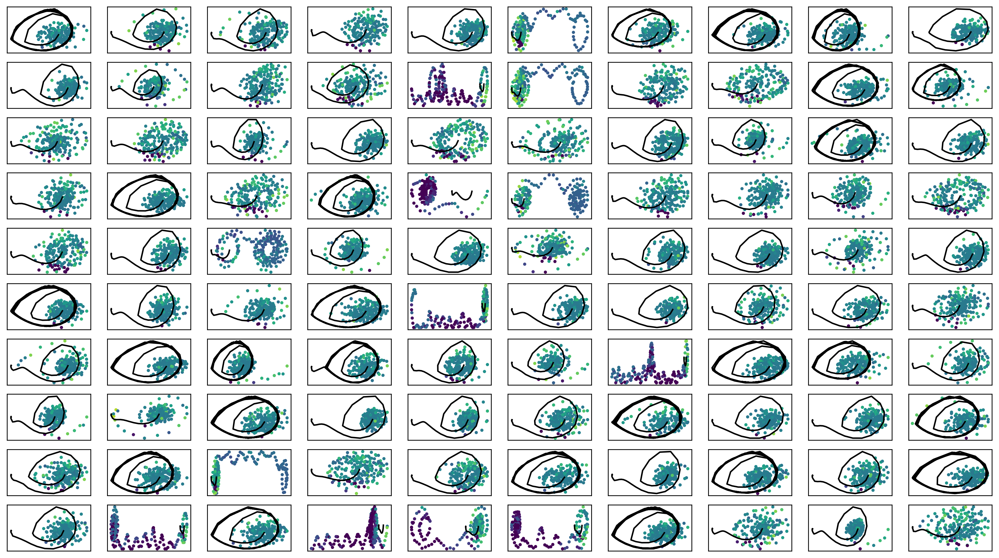

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -127.84198  validloss -133.23325±0.00000  bestvalidloss -133.23325  last_update 0
train: iter 1  trainloss -127.25482  validloss -134.98084±0.00000  bestvalidloss -134.98084  last_update 0
train: iter 2  trainloss -130.00679  validloss -137.38719±0.00000  bestvalidloss -137.38719  last_update 0
train: iter 3  trainloss -128.26291  validloss -124.13720±0.00000  bestvalidloss -137.38719  last_update 1
train: iter 4  trainloss -127.00016  validloss -134.51021±0.00000  bestvalidloss -137.38719  last_update 2
train: iter 5  trainloss -128.01599  validloss -136.52789±0.00000  bestvalidloss -137.38719  last_update 3
train: iter 6  trainloss -129.16101  validloss -134.01825±0.00000  bestvalidloss -137.38719  last_update 4
train: iter 7  trainloss -128.02912  validloss -135.96142±0.00000  bestvalidloss -137.38719  last_update 5
train: iter 8  trainloss -127.96176  validloss -138.26045±0.00000  bestvalidloss -138.26045  last_update 0
train: it

train: iter 76  trainloss -131.10257  validloss -138.87342±0.00000  bestvalidloss -140.26610  last_update 28
train: iter 77  trainloss -129.76586  validloss -131.98108±0.00000  bestvalidloss -140.26610  last_update 29
train: iter 78  trainloss -129.37258  validloss -131.07937±0.00000  bestvalidloss -140.26610  last_update 30
train: iter 79  trainloss -131.13848  validloss -134.74652±0.00000  bestvalidloss -140.26610  last_update 31
train: iter 80  trainloss -131.58400  validloss -140.67054±0.00000  bestvalidloss -140.67054  last_update 0
train: iter 81  trainloss -131.02884  validloss -134.73263±0.00000  bestvalidloss -140.67054  last_update 1
train: iter 82  trainloss -131.31265  validloss -133.08440±0.00000  bestvalidloss -140.67054  last_update 2
train: iter 83  trainloss -130.31291  validloss -134.80880±0.00000  bestvalidloss -140.67054  last_update 3
train: iter 84  trainloss -131.55522  validloss -138.93769±0.00000  bestvalidloss -140.67054  last_update 4
train: iter 85  trainlos

train: iter 151  trainloss -138.37205  validloss -134.88539±0.00000  bestvalidloss -142.79799  last_update 16
train: iter 152  trainloss -136.01263  validloss -138.86208±0.00000  bestvalidloss -142.79799  last_update 17
train: iter 153  trainloss -137.32208  validloss -130.44967±0.00000  bestvalidloss -142.79799  last_update 18
train: iter 154  trainloss -138.92587  validloss -139.78710±0.00000  bestvalidloss -142.79799  last_update 19
train: iter 155  trainloss -137.21368  validloss -135.60478±0.00000  bestvalidloss -142.79799  last_update 20
train: iter 156  trainloss -138.58207  validloss -138.37664±0.00000  bestvalidloss -142.79799  last_update 21
train: iter 157  trainloss -140.09978  validloss -134.35183±0.00000  bestvalidloss -142.79799  last_update 22
train: iter 158  trainloss -138.20476  validloss -130.61078±0.00000  bestvalidloss -142.79799  last_update 23
train: iter 159  trainloss -139.29378  validloss -140.39093±0.00000  bestvalidloss -142.79799  last_update 24
train: ite

train: iter 226  trainloss -146.43345  validloss -122.91205±0.00000  bestvalidloss -144.67682  last_update 52
train: iter 227  trainloss -144.67892  validloss -136.78158±0.00000  bestvalidloss -144.67682  last_update 53
train: iter 228  trainloss -146.04261  validloss -131.83956±0.00000  bestvalidloss -144.67682  last_update 54
train: iter 229  trainloss -144.30294  validloss -124.90826±0.00000  bestvalidloss -144.67682  last_update 55
train: iter 230  trainloss -144.66745  validloss -108.45352±0.00000  bestvalidloss -144.67682  last_update 56
train: iter 231  trainloss -145.22545  validloss -116.09701±0.00000  bestvalidloss -144.67682  last_update 57
train: iter 232  trainloss -146.05070  validloss -134.37275±0.00000  bestvalidloss -144.67682  last_update 58
train: iter 233  trainloss -145.59204  validloss -132.24155±0.00000  bestvalidloss -144.67682  last_update 59
train: iter 234  trainloss -146.85822  validloss -132.31994±0.00000  bestvalidloss -144.67682  last_update 60
train: ite

train: iter 301  trainloss -153.00218  validloss -121.52089±0.00000  bestvalidloss -150.33114  last_update 12
train: iter 302  trainloss -146.43873  validloss -135.76951±0.00000  bestvalidloss -150.33114  last_update 13
train: iter 303  trainloss -154.56483  validloss -149.36795±0.00000  bestvalidloss -150.33114  last_update 14
train: iter 304  trainloss -152.38469  validloss -129.61326±0.00000  bestvalidloss -150.33114  last_update 15
train: iter 305  trainloss -151.45783  validloss -134.55438±0.00000  bestvalidloss -150.33114  last_update 16
train: iter 306  trainloss -151.23581  validloss -136.08404±0.00000  bestvalidloss -150.33114  last_update 17
train: iter 307  trainloss -153.38421  validloss -135.04036±0.00000  bestvalidloss -150.33114  last_update 18
train: iter 308  trainloss -152.57807  validloss -101.39408±0.00000  bestvalidloss -150.33114  last_update 19
train: iter 309  trainloss -155.65070  validloss -144.49329±0.00000  bestvalidloss -150.33114  last_update 20
train: ite

train: iter 376  trainloss -163.34187  validloss -148.51690±0.00000  bestvalidloss -154.60588  last_update 12
train: iter 377  trainloss -162.30771  validloss -141.83422±0.00000  bestvalidloss -154.60588  last_update 13
train: iter 378  trainloss -162.50535  validloss -134.23355±0.00000  bestvalidloss -154.60588  last_update 14
train: iter 379  trainloss -161.88438  validloss -140.07730±0.00000  bestvalidloss -154.60588  last_update 15
train: iter 380  trainloss -163.09068  validloss -150.94601±0.00000  bestvalidloss -154.60588  last_update 16
train: iter 381  trainloss -162.82334  validloss -147.70147±0.00000  bestvalidloss -154.60588  last_update 17
train: iter 382  trainloss -163.36183  validloss -138.23465±0.00000  bestvalidloss -154.60588  last_update 18
train: iter 383  trainloss -164.22576  validloss -147.21966±0.00000  bestvalidloss -154.60588  last_update 19
train: iter 384  trainloss -162.18195  validloss -143.28282±0.00000  bestvalidloss -154.60588  last_update 20
train: ite

train: iter 451  trainloss -172.71692  validloss -145.40997±0.00000  bestvalidloss -164.76451  last_update 2
train: iter 452  trainloss -171.48270  validloss -164.94376±0.00000  bestvalidloss -164.94376  last_update 0
train: iter 453  trainloss -171.07259  validloss -149.45908±0.00000  bestvalidloss -164.94376  last_update 1
train: iter 454  trainloss -173.96072  validloss -163.70148±0.00000  bestvalidloss -164.94376  last_update 2
train: iter 455  trainloss -173.52132  validloss -161.89581±0.00000  bestvalidloss -164.94376  last_update 3
train: iter 456  trainloss -174.77146  validloss -155.25806±0.00000  bestvalidloss -164.94376  last_update 4
train: iter 457  trainloss -170.13700  validloss -151.51062±0.00000  bestvalidloss -164.94376  last_update 5
train: iter 458  trainloss -173.71407  validloss -150.80513±0.00000  bestvalidloss -164.94376  last_update 6
train: iter 459  trainloss -169.67210  validloss -166.11915±0.00000  bestvalidloss -166.11915  last_update 0
train: iter 460  tr

train: iter 527  trainloss -185.78339  validloss -167.75499±0.00000  bestvalidloss -179.45805  last_update 10
train: iter 528  trainloss -186.08046  validloss -167.61337±0.00000  bestvalidloss -179.45805  last_update 11
train: iter 529  trainloss -184.29963  validloss -173.19128±0.00000  bestvalidloss -179.45805  last_update 12
train: iter 530  trainloss -182.60955  validloss -178.22228±0.00000  bestvalidloss -179.45805  last_update 13
train: iter 531  trainloss -185.99630  validloss -170.68164±0.00000  bestvalidloss -179.45805  last_update 14
train: iter 532  trainloss -187.65776  validloss -167.50662±0.00000  bestvalidloss -179.45805  last_update 15
train: iter 533  trainloss -186.77508  validloss -185.76758±0.00000  bestvalidloss -185.76758  last_update 0
train: iter 534  trainloss -182.32842  validloss -152.90236±0.00000  bestvalidloss -185.76758  last_update 1
train: iter 535  trainloss -187.12921  validloss -172.10488±0.00000  bestvalidloss -185.76758  last_update 2
train: iter 5

train: iter 603  trainloss -196.11273  validloss -182.86203±0.00000  bestvalidloss -192.19180  last_update 6
train: iter 604  trainloss -193.45362  validloss -183.79003±0.00000  bestvalidloss -192.19180  last_update 7
train: iter 605  trainloss -192.86037  validloss -173.47732±0.00000  bestvalidloss -192.19180  last_update 8
train: iter 606  trainloss -189.98536  validloss -190.51376±0.00000  bestvalidloss -192.19180  last_update 9
train: iter 607  trainloss -190.18210  validloss -180.39998±0.00000  bestvalidloss -192.19180  last_update 10
train: iter 608  trainloss -190.70054  validloss -179.32581±0.00000  bestvalidloss -192.19180  last_update 11
train: iter 609  trainloss -189.42727  validloss -174.53889±0.00000  bestvalidloss -192.19180  last_update 12
train: iter 610  trainloss -192.77143  validloss -177.77151±0.00000  bestvalidloss -192.19180  last_update 13
train: iter 611  trainloss -194.44354  validloss -185.68932±0.00000  bestvalidloss -192.19180  last_update 14
train: iter 61

train: iter 679  trainloss -196.55271  validloss -141.88795±0.00000  bestvalidloss -196.42436  last_update 26
train: iter 680  trainloss -193.82641  validloss -191.00957±0.00000  bestvalidloss -196.42436  last_update 27
train: iter 681  trainloss -201.26345  validloss -175.96250±0.00000  bestvalidloss -196.42436  last_update 28
train: iter 682  trainloss -200.18631  validloss -186.95405±0.00000  bestvalidloss -196.42436  last_update 29
train: iter 683  trainloss -199.49117  validloss -187.42236±0.00000  bestvalidloss -196.42436  last_update 30
train: iter 684  trainloss -199.98519  validloss -190.14298±0.00000  bestvalidloss -196.42436  last_update 31
train: iter 685  trainloss -197.03781  validloss -183.95804±0.00000  bestvalidloss -196.42436  last_update 32
train: iter 686  trainloss -197.50475  validloss -181.99911±0.00000  bestvalidloss -196.42436  last_update 33
train: iter 687  trainloss -199.89892  validloss -190.14389±0.00000  bestvalidloss -196.42436  last_update 34
train: ite

train: iter 755  trainloss -196.21661  validloss -172.13276±0.00000  bestvalidloss -202.78759  last_update 21
train: iter 756  trainloss -208.31015  validloss -195.09110±0.00000  bestvalidloss -202.78759  last_update 22
train: iter 757  trainloss -203.94182  validloss -198.91943±0.00000  bestvalidloss -202.78759  last_update 23
train: iter 758  trainloss -205.69409  validloss -186.52693±0.00000  bestvalidloss -202.78759  last_update 24
train: iter 759  trainloss -202.78877  validloss -188.39629±0.00000  bestvalidloss -202.78759  last_update 25
train: iter 760  trainloss -202.10984  validloss -176.87602±0.00000  bestvalidloss -202.78759  last_update 26
train: iter 761  trainloss -198.92472  validloss -184.98826±0.00000  bestvalidloss -202.78759  last_update 27
train: iter 762  trainloss -206.37268  validloss -188.72969±0.00000  bestvalidloss -202.78759  last_update 28
train: iter 763  trainloss -205.82336  validloss -204.19356±0.00000  bestvalidloss -204.19356  last_update 0
train: iter

train: iter 830  trainloss -207.82624  validloss -189.79031±0.00000  bestvalidloss -209.55176  last_update 2
train: iter 831  trainloss -205.09521  validloss -153.57898±0.00000  bestvalidloss -209.55176  last_update 3
train: iter 832  trainloss -207.89588  validloss -179.00082±0.00000  bestvalidloss -209.55176  last_update 4
train: iter 833  trainloss -210.10842  validloss -195.01490±0.00000  bestvalidloss -209.55176  last_update 5
train: iter 834  trainloss -204.72182  validloss -186.45473±0.00000  bestvalidloss -209.55176  last_update 6
train: iter 835  trainloss -206.59213  validloss -197.80276±0.00000  bestvalidloss -209.55176  last_update 7
train: iter 836  trainloss -207.95436  validloss -185.57439±0.00000  bestvalidloss -209.55176  last_update 8
train: iter 837  trainloss -210.47161  validloss -187.06716±0.00000  bestvalidloss -209.55176  last_update 9
train: iter 838  trainloss -210.51233  validloss -188.89523±0.00000  bestvalidloss -209.55176  last_update 10
train: iter 839  t

train: iter 905  trainloss -201.85600  validloss -177.00447±0.00000  bestvalidloss -210.65714  last_update 56
train: iter 906  trainloss -208.14057  validloss -182.65141±0.00000  bestvalidloss -210.65714  last_update 57
train: iter 907  trainloss -210.68016  validloss -207.73945±0.00000  bestvalidloss -210.65714  last_update 58
train: iter 908  trainloss -209.99757  validloss -191.52449±0.00000  bestvalidloss -210.65714  last_update 59
train: iter 909  trainloss -212.23401  validloss -193.28646±0.00000  bestvalidloss -210.65714  last_update 60
train: iter 910  trainloss -210.98023  validloss -200.83111±0.00000  bestvalidloss -210.65714  last_update 61
train: iter 911  trainloss -213.32221  validloss -199.58101±0.00000  bestvalidloss -210.65714  last_update 62
train: iter 912  trainloss -202.34598  validloss -196.34640±0.00000  bestvalidloss -210.65714  last_update 63
train: iter 913  trainloss -210.27182  validloss -182.06932±0.00000  bestvalidloss -210.65714  last_update 64
train: ite

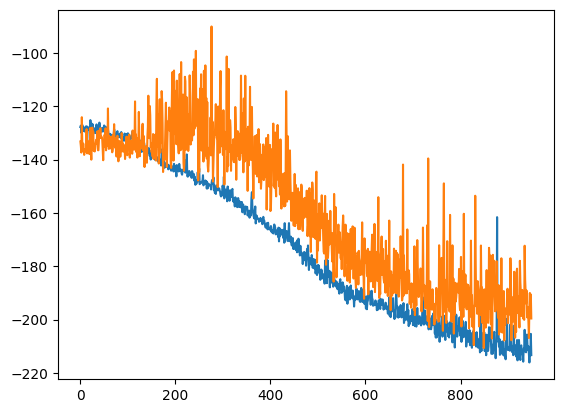

train_weighted_vae: enc
train: iter 0  trainloss -216.73109  validloss -202.65054±0.00000  bestvalidloss -202.65054  last_update 0
train: iter 1  trainloss -215.12720  validloss -197.26873±0.00000  bestvalidloss -202.65054  last_update 1
train: iter 2  trainloss -215.61142  validloss -192.33321±0.00000  bestvalidloss -202.65054  last_update 2
train: iter 3  trainloss -218.30152  validloss -195.67374±0.00000  bestvalidloss -202.65054  last_update 3
train: iter 4  trainloss -218.67756  validloss -195.85743±0.00000  bestvalidloss -202.65054  last_update 4
train: iter 5  trainloss -218.30765  validloss -203.55619±0.00000  bestvalidloss -203.55619  last_update 0
train: iter 6  trainloss -218.55977  validloss -193.05740±0.00000  bestvalidloss -203.55619  last_update 1
train: iter 7  trainloss -217.86730  validloss -195.77522±0.00000  bestvalidloss -203.55619  last_update 2
train: iter 8  trainloss -217.91859  validloss -202.39073±0.00000  bestvalidloss -203.55619  last_update 3
train: iter 9

train: iter 77  trainloss -216.36642  validloss -200.06541±0.00000  bestvalidloss -208.42753  last_update 19
train: iter 78  trainloss -217.88190  validloss -201.15442±0.00000  bestvalidloss -208.42753  last_update 20
train: iter 79  trainloss -216.34903  validloss -198.72146±0.00000  bestvalidloss -208.42753  last_update 21
train: iter 80  trainloss -215.54720  validloss -206.74195±0.00000  bestvalidloss -208.42753  last_update 22
train: iter 81  trainloss -215.15312  validloss -195.77107±0.00000  bestvalidloss -208.42753  last_update 23
train: iter 82  trainloss -217.89137  validloss -194.33083±0.00000  bestvalidloss -208.42753  last_update 24
train: iter 83  trainloss -218.02682  validloss -201.78108±0.00000  bestvalidloss -208.42753  last_update 25
train: iter 84  trainloss -217.60085  validloss -200.22532±0.00000  bestvalidloss -208.42753  last_update 26
train: iter 85  trainloss -217.28051  validloss -199.36155±0.00000  bestvalidloss -208.42753  last_update 27
train: iter 86  tra

train: iter 152  trainloss -218.70445  validloss -203.16240±0.00000  bestvalidloss -208.42753  last_update 94
train: iter 153  trainloss -216.92725  validloss -190.73417±0.00000  bestvalidloss -208.42753  last_update 95
train: iter 154  trainloss -217.17826  validloss -199.02356±0.00000  bestvalidloss -208.42753  last_update 96
train: iter 155  trainloss -214.63426  validloss -201.60049±0.00000  bestvalidloss -208.42753  last_update 97
train: iter 156  trainloss -219.07019  validloss -198.77884±0.00000  bestvalidloss -208.42753  last_update 98
train: iter 157  trainloss -215.39010  validloss -201.40339±0.00000  bestvalidloss -208.42753  last_update 99
train: iter 158  trainloss -216.82979  validloss -194.12669±0.00000  bestvalidloss -208.42753  last_update 100
train: fin


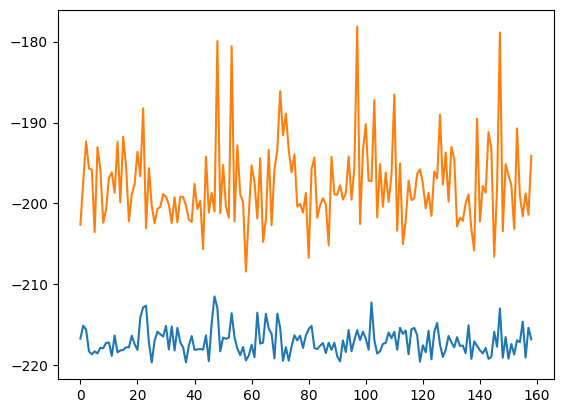

train_weighted_vae: dec
train: iter 0  trainloss -213.01472  validloss -199.51730±0.00000  bestvalidloss -199.51730  last_update 0
train: iter 1  trainloss -216.69498  validloss -201.37139±0.00000  bestvalidloss -201.37139  last_update 0
train: iter 2  trainloss -217.28472  validloss -198.50075±0.00000  bestvalidloss -201.37139  last_update 1
train: iter 3  trainloss -209.25813  validloss -185.18659±0.00000  bestvalidloss -201.37139  last_update 2
train: iter 4  trainloss -217.31186  validloss -195.97966±0.00000  bestvalidloss -201.37139  last_update 3
train: iter 5  trainloss -219.13748  validloss -191.10587±0.00000  bestvalidloss -201.37139  last_update 4
train: iter 6  trainloss -215.55351  validloss -193.64329±0.00000  bestvalidloss -201.37139  last_update 5
train: iter 7  trainloss -214.45306  validloss -182.51919±0.00000  bestvalidloss -201.37139  last_update 6
train: iter 8  trainloss -217.31025  validloss -195.35437±0.00000  bestvalidloss -201.37139  last_update 7
train: iter 9

train: iter 76  trainloss -218.26258  validloss -188.75578±0.00000  bestvalidloss -203.28478  last_update 38
train: iter 77  trainloss -214.86606  validloss -193.80985±0.00000  bestvalidloss -203.28478  last_update 39
train: iter 78  trainloss -217.30785  validloss -196.18456±0.00000  bestvalidloss -203.28478  last_update 40
train: iter 79  trainloss -215.36802  validloss -194.34329±0.00000  bestvalidloss -203.28478  last_update 41
train: iter 80  trainloss -217.36811  validloss -202.31749±0.00000  bestvalidloss -203.28478  last_update 42
train: iter 81  trainloss -217.11182  validloss -192.14548±0.00000  bestvalidloss -203.28478  last_update 43
train: iter 82  trainloss -215.10414  validloss -177.74077±0.00000  bestvalidloss -203.28478  last_update 44
train: iter 83  trainloss -219.15529  validloss -195.87129±0.00000  bestvalidloss -203.28478  last_update 45
train: iter 84  trainloss -218.14031  validloss -190.34527±0.00000  bestvalidloss -203.28478  last_update 46
train: iter 85  tra

train: iter 152  trainloss -218.49753  validloss -197.23790±0.00000  bestvalidloss -205.72650  last_update 46
train: iter 153  trainloss -219.29519  validloss -193.54109±0.00000  bestvalidloss -205.72650  last_update 47
train: iter 154  trainloss -216.83950  validloss -170.90861±0.00000  bestvalidloss -205.72650  last_update 48
train: iter 155  trainloss -220.37506  validloss -191.64494±0.00000  bestvalidloss -205.72650  last_update 49
train: iter 156  trainloss -214.72983  validloss -189.44597±0.00000  bestvalidloss -205.72650  last_update 50
train: iter 157  trainloss -219.54637  validloss -201.98387±0.00000  bestvalidloss -205.72650  last_update 51
train: iter 158  trainloss -215.45302  validloss -191.25139±0.00000  bestvalidloss -205.72650  last_update 52
train: iter 159  trainloss -219.80011  validloss -196.24763±0.00000  bestvalidloss -205.72650  last_update 53
train: iter 160  trainloss -218.84218  validloss -191.66528±0.00000  bestvalidloss -205.72650  last_update 54
train: ite

train: iter 227  trainloss -217.61968  validloss -186.41678±0.00000  bestvalidloss -211.17353  last_update 32
train: iter 228  trainloss -219.16352  validloss -198.07289±0.00000  bestvalidloss -211.17353  last_update 33
train: iter 229  trainloss -212.09639  validloss -183.08294±0.00000  bestvalidloss -211.17353  last_update 34
train: iter 230  trainloss -217.89897  validloss -200.66798±0.00000  bestvalidloss -211.17353  last_update 35
train: iter 231  trainloss -217.70508  validloss -192.02817±0.00000  bestvalidloss -211.17353  last_update 36
train: iter 232  trainloss -219.14143  validloss -201.37169±0.00000  bestvalidloss -211.17353  last_update 37
train: iter 233  trainloss -217.17348  validloss -182.09533±0.00000  bestvalidloss -211.17353  last_update 38
train: iter 234  trainloss -217.19671  validloss -190.21050±0.00000  bestvalidloss -211.17353  last_update 39
train: iter 235  trainloss -217.81151  validloss -189.42475±0.00000  bestvalidloss -211.17353  last_update 40
train: ite

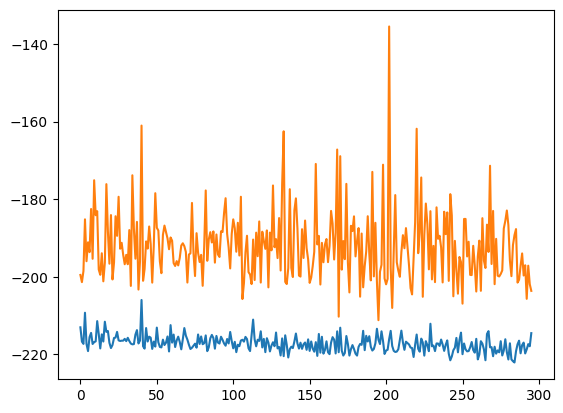

alpha 0.3 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.20534087958345404
1  c = 0.0740567357096577
2  c = 0.1404410427517666
3  c = 0.20117234269839127
4  c = 0.013938403035175883
5  c = 0.29500819718020055
6  c = 0.031665646760175324
7  c = 0.18190899118772483
8  c = 0.2777374422464309
9  c = 0.20171106462171026
10  c = 0.06199993885243635
11  c = 0.24247096077055444
12  c = 0.010395551650482181
13  c = 0.2703923804090848
14  c = 0.12039955886613532
15  c = 0.2685163634529598
16  c = 0.24929032876896023
17  c = 0.2504178348869055
18  c = 0.039003507619449325
19  c = 0.2850527432045068
20  c = 0.25694174780708007
21  c = 0.2665457522405091
22  c = 0.11070367084702977
23  c = 0.29006504842276903
24  c = 0.2524832441209644
25  c = 0.2677727197276234
26  c = 0.25707565258367626
27  c = 0.239584216199407
28  c = 0.06329453032338606
29  c = 0.10644789401813297
30  c = 0.049203042990572134
31  c = 0.027436808131261956
32  c = 0.10733375028017894
33  c = 0.20549668549573682
34  c = 0.1828253167839896
35  c = 0.2936165057705113
36  c = 0.

98  c = 0.17215891288892812
99  c = 0.163448194438249
 
実環境方策rollout vs Sim環境方策rollout


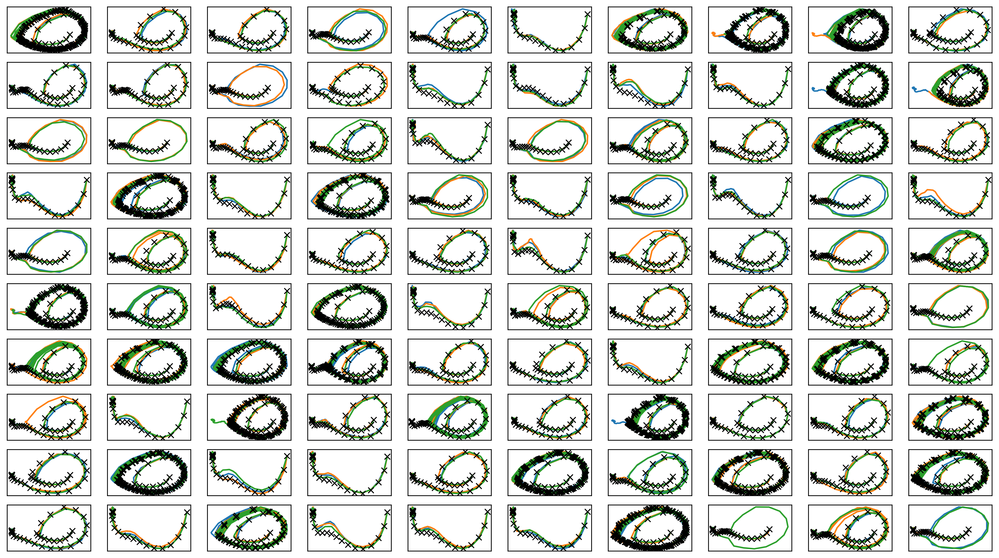

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

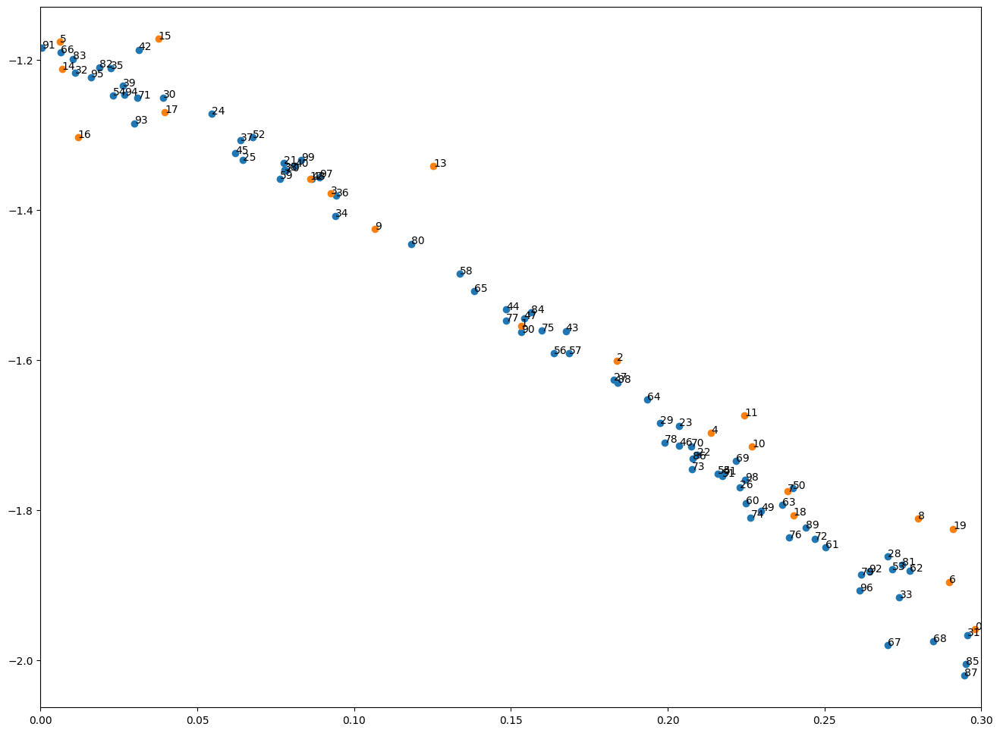

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-04-04 02:15:01.305930


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.2735614428593289
c = 0.19737632234231595
c = 0.24663490782727085
c = 0.0035345422851367657
c = 0.2138214998350688
c = 0.11712153491338158
c = 0.026382393829457784
c = 0.13753590733950216
c = 0.15512300780671862
c = 0.1043062674908136
c = 0.035461074056585995
c = 0.08564022264944944
c = 0.22483842647594376
1  c = 0.12164532229593572
c = 0.14477620463839433
c = 0.06125080109205028
c = 0.1740888597409452
c = 0.1009849463968301
2  c = 0.005493340718227679
c = 0.07216181595909328
c = 0.2290637577160764
c = 0.04373509185232009
c = 0.14449775033585244
c = 0.0070565020645093285
c = 0.2501012851067011
c = 0.17327267631023333
c = 0.12769009936150044
c = 0.04378156996329058
c = 0.15223125404611523
c = 0.17136318923694038
3  c = 0.11884327218636599
c = 0.24046260598496277
c = 0.17903701072660497
c = 0.2136129307934426
c = 0.1903076190304571
4  c = 0.23317945669240642
c = 0.259621630433307
c = 0.1402214363241976
c = 0.20393019335912893
c = 0.26155974665579906
c = 0.20404723320313325
c = 0.

c = 0.1302157093388894
c = 0.22349030030405526
c = 0.26481606586876666
c = 0.27263598394041666
c = 0.27473315651641833
38  c = 0.10016155875791793
c = 0.24867660754648796
c = 0.16775267023023702
c = 0.1304841740359288
c = 0.16863887928768762
c = 0.06091094790298213
c = 0.12667425868838
c = 0.08650565521174036
c = 0.06537933173771378
39  c = 0.021026007182114392
c = 0.030508015987150826
c = 0.2538313962288225
c = 0.2570778663794059
c = 0.13392588363799857
c = 0.09077134539859859
c = 0.13641888944380182
40  c = 0.25676751228754613
c = 0.15349358638982435
c = 0.031810985938634025
c = 0.23287922381327314
c = 0.13222264963458413
c = 0.17366192188513063
c = 0.06367661225233025
c = 0.23350412723737965
c = 0.019489177978912586
c = 0.26363215769311443
c = 0.024496090408954996
41  c = 0.018777433748862638
c = 0.25496874509860273
c = 0.23634460734105475
c = 0.2031565773618724
42  c = 0.1974063960663662
c = 0.2628673367119624
c = 0.09339274536524078
c = 0.22099718046992664
c = 0.10670848670201388


76  c = 0.1661717286406553
c = 0.024857694946325126
c = 0.252071885630258
c = 0.08729250329460249
c = 0.05185372226900141
c = 0.10107722689884245
c = 0.17335215972644663
77  c = 0.059871146315058375
c = 0.2841453353424276
c = 0.2158768047622705
c = 0.19066849525277366
c = 0.2853749726463039
c = 0.19893816545905443
c = 0.26313051817439237
c = 0.24841453540726643
c = 0.14410357064030993
78  c = 0.08258720678758866
c = 0.16912652281363674
c = 0.17030572535614388
c = 0.12538590569824937
79  c = 0.17861504349331941
c = 0.24510327605869373
c = 0.23086568000044314
c = 0.03498669642523173
c = 0.09671061270981508
c = 0.06753989892639457
c = 0.03381041027453215
c = 0.04127597985954335
c = 0.290655956794083
c = 0.17025938289363038
c = 0.0019776149374784668
c = 0.24777559153426937
c = 0.05039953661488537
c = 0.27559883421186043
c = 0.21974441408268258
c = 0.26009436467153846
c = 0.1571777895957095
80  c = 0.035062400287329896
c = 0.0749252695148361
c = 0.16255029020705278
c = 0.0878986040246878
c 

In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.21658  validloss 0.35846±0.00000  bestvalidloss 0.35846  last_update 0
train: iter 1  trainloss 0.17285  validloss 0.19375±0.00000  bestvalidloss 0.19375  last_update 0
train: iter 2  trainloss 0.16902  validloss 0.19060±0.00000  bestvalidloss 0.19060  last_update 0
train: iter 3  trainloss 0.16302  validloss 0.18202±0.00000  bestvalidloss 0.18202  last_update 0
train: iter 4  trainloss 0.15510  validloss 0.18103±0.00000  bestvalidloss 0.18103  last_update 0
train: iter 5  trainloss 0.15306  validloss 0.17797±0.00000  bestvalidloss 0.17797  last_update 0
train: iter 6  trainloss 0.14893  validloss 0.17280±0.00000  bestvalidloss 0.17280  last_update 0
train: iter 7  trainloss 0.14609  validloss 0.16932±0.00000  bestvalidloss 0.16932  last_update 0
train: iter 8  trainloss 0.14799  validloss 0.17604±0.00000  bestvalidloss 0.16932  last_update 1
train: iter 9  trainloss 0.14461  validloss 0.17413±0.00000  bestvalidloss 0.16932  last_update 2
train: iter 10  trai

train: iter 84  trainloss 0.12859  validloss 0.16815±0.00000  bestvalidloss 0.15968  last_update 31
train: iter 85  trainloss 0.12978  validloss 0.16134±0.00000  bestvalidloss 0.15968  last_update 32
train: iter 86  trainloss 0.12955  validloss 0.16185±0.00000  bestvalidloss 0.15968  last_update 33
train: iter 87  trainloss 0.12931  validloss 0.15894±0.00000  bestvalidloss 0.15894  last_update 0
train: iter 88  trainloss 0.12992  validloss 0.15857±0.00000  bestvalidloss 0.15857  last_update 0
train: iter 89  trainloss 0.12909  validloss 0.17028±0.00000  bestvalidloss 0.15857  last_update 1
train: iter 90  trainloss 0.12937  validloss 0.16664±0.00000  bestvalidloss 0.15857  last_update 2
train: iter 91  trainloss 0.12869  validloss 0.16472±0.00000  bestvalidloss 0.15857  last_update 3
train: iter 92  trainloss 0.13098  validloss 0.16155±0.00000  bestvalidloss 0.15857  last_update 4
train: iter 93  trainloss 0.13107  validloss 0.16977±0.00000  bestvalidloss 0.15857  last_update 5
train: 

train: iter 167  trainloss 0.12541  validloss 0.15750±0.00000  bestvalidloss 0.15492  last_update 18
train: iter 168  trainloss 0.12527  validloss 0.15669±0.00000  bestvalidloss 0.15492  last_update 19
train: iter 169  trainloss 0.12476  validloss 0.16046±0.00000  bestvalidloss 0.15492  last_update 20
train: iter 170  trainloss 0.12406  validloss 0.15879±0.00000  bestvalidloss 0.15492  last_update 21
train: iter 171  trainloss 0.12523  validloss 0.15551±0.00000  bestvalidloss 0.15492  last_update 22
train: iter 172  trainloss 0.12530  validloss 0.15726±0.00000  bestvalidloss 0.15492  last_update 23
train: iter 173  trainloss 0.12461  validloss 0.15947±0.00000  bestvalidloss 0.15492  last_update 24
train: iter 174  trainloss 0.12455  validloss 0.15435±0.00000  bestvalidloss 0.15435  last_update 0
train: iter 175  trainloss 0.12566  validloss 0.15909±0.00000  bestvalidloss 0.15435  last_update 1
train: iter 176  trainloss 0.12404  validloss 0.15908±0.00000  bestvalidloss 0.15435  last_up

train: iter 249  trainloss 0.12302  validloss 0.15464±0.00000  bestvalidloss 0.15247  last_update 65
train: iter 250  trainloss 0.12090  validloss 0.16298±0.00000  bestvalidloss 0.15247  last_update 66
train: iter 251  trainloss 0.12267  validloss 0.15923±0.00000  bestvalidloss 0.15247  last_update 67
train: iter 252  trainloss 0.12098  validloss 0.15957±0.00000  bestvalidloss 0.15247  last_update 68
train: iter 253  trainloss 0.12055  validloss 0.15896±0.00000  bestvalidloss 0.15247  last_update 69
train: iter 254  trainloss 0.12281  validloss 0.15873±0.00000  bestvalidloss 0.15247  last_update 70
train: iter 255  trainloss 0.12267  validloss 0.15598±0.00000  bestvalidloss 0.15247  last_update 71
train: iter 256  trainloss 0.12312  validloss 0.15473±0.00000  bestvalidloss 0.15247  last_update 72
train: iter 257  trainloss 0.12327  validloss 0.15629±0.00000  bestvalidloss 0.15247  last_update 73
train: iter 258  trainloss 0.12259  validloss 0.16012±0.00000  bestvalidloss 0.15247  last_

train: iter 331  trainloss 0.12089  validloss 0.15954±0.00000  bestvalidloss 0.15215  last_update 21
train: iter 332  trainloss 0.11898  validloss 0.15790±0.00000  bestvalidloss 0.15215  last_update 22
train: iter 333  trainloss 0.11945  validloss 0.16241±0.00000  bestvalidloss 0.15215  last_update 23
train: iter 334  trainloss 0.11967  validloss 0.15925±0.00000  bestvalidloss 0.15215  last_update 24
train: iter 335  trainloss 0.11971  validloss 0.15242±0.00000  bestvalidloss 0.15215  last_update 25
train: iter 336  trainloss 0.11981  validloss 0.15630±0.00000  bestvalidloss 0.15215  last_update 26
train: iter 337  trainloss 0.11968  validloss 0.15622±0.00000  bestvalidloss 0.15215  last_update 27
train: iter 338  trainloss 0.12047  validloss 0.16313±0.00000  bestvalidloss 0.15215  last_update 28
train: iter 339  trainloss 0.11941  validloss 0.15443±0.00000  bestvalidloss 0.15215  last_update 29
train: iter 340  trainloss 0.12129  validloss 0.15598±0.00000  bestvalidloss 0.15215  last_

train: iter 414  trainloss 0.11927  validloss 0.15409±0.00000  bestvalidloss 0.15182  last_update 52
train: iter 415  trainloss 0.11813  validloss 0.15239±0.00000  bestvalidloss 0.15182  last_update 53
train: iter 416  trainloss 0.11895  validloss 0.15274±0.00000  bestvalidloss 0.15182  last_update 54
train: iter 417  trainloss 0.11754  validloss 0.15548±0.00000  bestvalidloss 0.15182  last_update 55
train: iter 418  trainloss 0.11794  validloss 0.15387±0.00000  bestvalidloss 0.15182  last_update 56
train: iter 419  trainloss 0.11760  validloss 0.15759±0.00000  bestvalidloss 0.15182  last_update 57
train: iter 420  trainloss 0.11659  validloss 0.15427±0.00000  bestvalidloss 0.15182  last_update 58
train: iter 421  trainloss 0.11837  validloss 0.15306±0.00000  bestvalidloss 0.15182  last_update 59
train: iter 422  trainloss 0.11737  validloss 0.15087±0.00000  bestvalidloss 0.15087  last_update 0
train: iter 423  trainloss 0.11811  validloss 0.15309±0.00000  bestvalidloss 0.15087  last_u

train: iter 497  trainloss 0.11698  validloss 0.15829±0.00000  bestvalidloss 0.15087  last_update 75
train: iter 498  trainloss 0.11604  validloss 0.15265±0.00000  bestvalidloss 0.15087  last_update 76
train: iter 499  trainloss 0.11691  validloss 0.15657±0.00000  bestvalidloss 0.15087  last_update 77
train: iter 500  trainloss 0.11571  validloss 0.15338±0.00000  bestvalidloss 0.15087  last_update 78
train: iter 501  trainloss 0.11585  validloss 0.15365±0.00000  bestvalidloss 0.15087  last_update 79
train: iter 502  trainloss 0.11487  validloss 0.15315±0.00000  bestvalidloss 0.15087  last_update 80
train: iter 503  trainloss 0.11611  validloss 0.15828±0.00000  bestvalidloss 0.15087  last_update 81
train: iter 504  trainloss 0.11532  validloss 0.15551±0.00000  bestvalidloss 0.15087  last_update 82
train: iter 505  trainloss 0.11636  validloss 0.15385±0.00000  bestvalidloss 0.15087  last_update 83
train: iter 506  trainloss 0.11534  validloss 0.15477±0.00000  bestvalidloss 0.15087  last_

In [33]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -158.74761952519415
valid_loss:  -282.0438759422302
train_loss:  -177.70774782419204
valid_loss:  -175.61526822090147


1e-08 1000.0


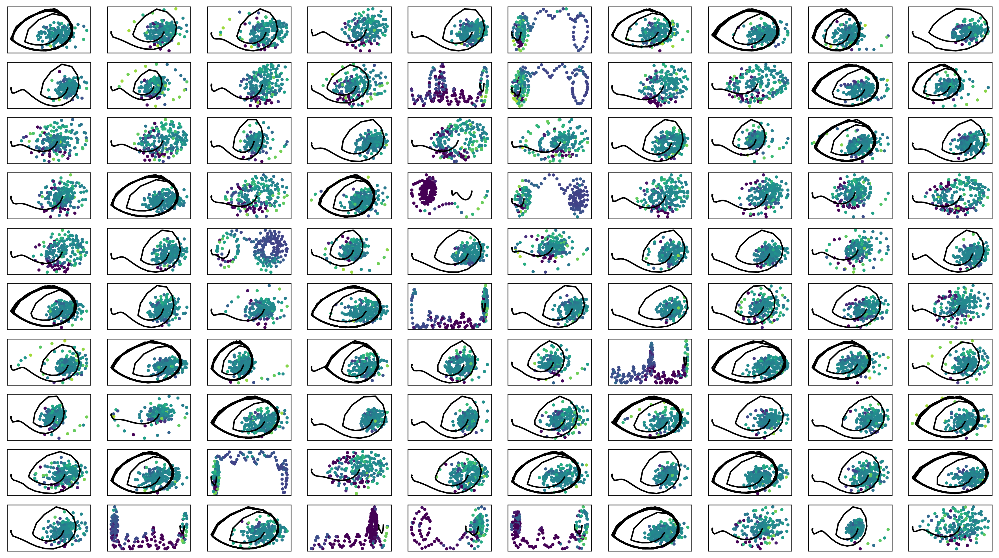

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -177.83440  validloss -176.31345±0.00000  bestvalidloss -176.31345  last_update 0
train: iter 1  trainloss -175.43705  validloss -167.13002±0.00000  bestvalidloss -176.31345  last_update 1
train: iter 2  trainloss -174.47219  validloss -165.15479±0.00000  bestvalidloss -176.31345  last_update 2
train: iter 3  trainloss -179.79470  validloss -172.15319±0.00000  bestvalidloss -176.31345  last_update 3
train: iter 4  trainloss -174.89278  validloss -174.68238±0.00000  bestvalidloss -176.31345  last_update 4
train: iter 5  trainloss -174.88544  validloss -135.54261±0.00000  bestvalidloss -176.31345  last_update 5
train: iter 6  trainloss -179.79622  validloss -167.95937±0.00000  bestvalidloss -176.31345  last_update 6
train: iter 7  trainloss -179.05679  validloss -162.00997±0.00000  bestvalidloss -176.31345  last_update 7
train: iter 8  trainloss -179.13332  validloss -176.27584±0.00000  bestvalidloss -176.31345  last_update 8
train: it

train: iter 76  trainloss -175.26145  validloss -172.12554±0.00000  bestvalidloss -182.82312  last_update 61
train: iter 77  trainloss -179.08952  validloss -156.34545±0.00000  bestvalidloss -182.82312  last_update 62
train: iter 78  trainloss -174.47236  validloss -169.14325±0.00000  bestvalidloss -182.82312  last_update 63
train: iter 79  trainloss -176.21028  validloss -170.08011±0.00000  bestvalidloss -182.82312  last_update 64
train: iter 80  trainloss -178.92462  validloss -160.06835±0.00000  bestvalidloss -182.82312  last_update 65
train: iter 81  trainloss -175.55653  validloss -167.39318±0.00000  bestvalidloss -182.82312  last_update 66
train: iter 82  trainloss -176.01539  validloss -158.44627±0.00000  bestvalidloss -182.82312  last_update 67
train: iter 83  trainloss -178.66106  validloss -166.14989±0.00000  bestvalidloss -182.82312  last_update 68
train: iter 84  trainloss -178.95048  validloss -159.76793±0.00000  bestvalidloss -182.82312  last_update 69
train: iter 85  tra

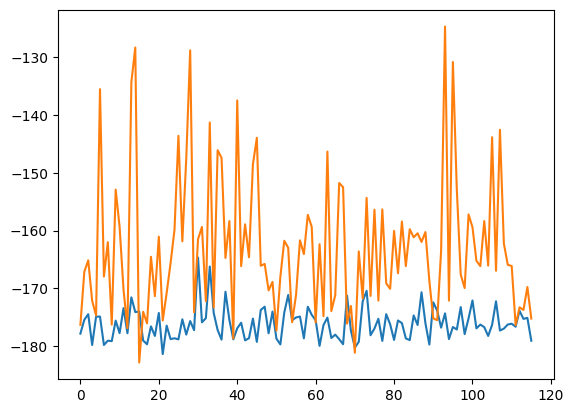

train_weighted_vae: enc
train: iter 0  trainloss -173.12170  validloss -168.09419±0.00000  bestvalidloss -168.09419  last_update 0
train: iter 1  trainloss -176.24796  validloss -161.81519±0.00000  bestvalidloss -168.09419  last_update 1
train: iter 2  trainloss -176.99157  validloss -156.85414±0.00000  bestvalidloss -168.09419  last_update 2
train: iter 3  trainloss -174.88840  validloss -168.27300±0.00000  bestvalidloss -168.27300  last_update 0
train: iter 4  trainloss -175.32531  validloss -179.83484±0.00000  bestvalidloss -179.83484  last_update 0
train: iter 5  trainloss -174.03314  validloss -168.36057±0.00000  bestvalidloss -179.83484  last_update 1
train: iter 6  trainloss -175.60837  validloss -172.14067±0.00000  bestvalidloss -179.83484  last_update 2
train: iter 7  trainloss -176.11407  validloss -148.76196±0.00000  bestvalidloss -179.83484  last_update 3
train: iter 8  trainloss -176.16956  validloss -162.01414±0.00000  bestvalidloss -179.83484  last_update 4
train: iter 9

train: iter 76  trainloss -177.72520  validloss -157.64592±0.00000  bestvalidloss -179.83484  last_update 72
train: iter 77  trainloss -176.13364  validloss -162.66156±0.00000  bestvalidloss -179.83484  last_update 73
train: iter 78  trainloss -173.80462  validloss -140.63585±0.00000  bestvalidloss -179.83484  last_update 74
train: iter 79  trainloss -175.40684  validloss -163.61123±0.00000  bestvalidloss -179.83484  last_update 75
train: iter 80  trainloss -177.70920  validloss -156.69982±0.00000  bestvalidloss -179.83484  last_update 76
train: iter 81  trainloss -177.34063  validloss -161.37989±0.00000  bestvalidloss -179.83484  last_update 77
train: iter 82  trainloss -178.25473  validloss -157.13871±0.00000  bestvalidloss -179.83484  last_update 78
train: iter 83  trainloss -174.45779  validloss -169.40012±0.00000  bestvalidloss -179.83484  last_update 79
train: iter 84  trainloss -173.46649  validloss -142.90208±0.00000  bestvalidloss -179.83484  last_update 80
train: iter 85  tra

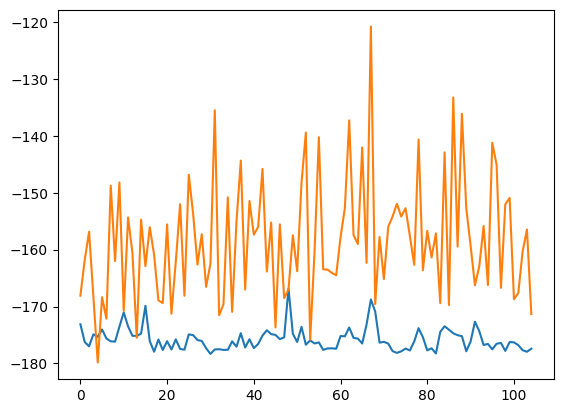

train_weighted_vae: dec
train: iter 0  trainloss -175.68867  validloss -156.68605±0.00000  bestvalidloss -156.68605  last_update 0
train: iter 1  trainloss -176.17500  validloss -164.99540±0.00000  bestvalidloss -164.99540  last_update 0
train: iter 2  trainloss -177.93430  validloss -161.11946±0.00000  bestvalidloss -164.99540  last_update 1
train: iter 3  trainloss -177.82974  validloss -148.16221±0.00000  bestvalidloss -164.99540  last_update 2
train: iter 4  trainloss -175.61430  validloss -160.01656±0.00000  bestvalidloss -164.99540  last_update 3
train: iter 5  trainloss -177.46360  validloss -147.82429±0.00000  bestvalidloss -164.99540  last_update 4
train: iter 6  trainloss -175.58079  validloss -162.10225±0.00000  bestvalidloss -164.99540  last_update 5
train: iter 7  trainloss -178.99934  validloss -155.93967±0.00000  bestvalidloss -164.99540  last_update 6
train: iter 8  trainloss -176.87357  validloss -152.30364±0.00000  bestvalidloss -164.99540  last_update 7
train: iter 9

train: iter 77  trainloss -177.47737  validloss -165.05796±0.00000  bestvalidloss -172.02879  last_update 11
train: iter 78  trainloss -176.84260  validloss -163.31635±0.00000  bestvalidloss -172.02879  last_update 12
train: iter 79  trainloss -174.57325  validloss -155.24323±0.00000  bestvalidloss -172.02879  last_update 13
train: iter 80  trainloss -177.94621  validloss -167.78863±0.00000  bestvalidloss -172.02879  last_update 14
train: iter 81  trainloss -174.30227  validloss -163.76717±0.00000  bestvalidloss -172.02879  last_update 15
train: iter 82  trainloss -176.91877  validloss -159.38594±0.00000  bestvalidloss -172.02879  last_update 16
train: iter 83  trainloss -175.58052  validloss -136.39564±0.00000  bestvalidloss -172.02879  last_update 17
train: iter 84  trainloss -178.16715  validloss -162.13759±0.00000  bestvalidloss -172.02879  last_update 18
train: iter 85  trainloss -177.73467  validloss -101.36638±0.00000  bestvalidloss -172.02879  last_update 19
train: iter 86  tra

train: iter 153  trainloss -178.49203  validloss -165.12763±0.00000  bestvalidloss -172.02879  last_update 87
train: iter 154  trainloss -178.99708  validloss -147.71789±0.00000  bestvalidloss -172.02879  last_update 88
train: iter 155  trainloss -177.09575  validloss -163.43375±0.00000  bestvalidloss -172.02879  last_update 89
train: iter 156  trainloss -178.08771  validloss -154.86058±0.00000  bestvalidloss -172.02879  last_update 90
train: iter 157  trainloss -178.68491  validloss -158.04888±0.00000  bestvalidloss -172.02879  last_update 91
train: iter 158  trainloss -177.44023  validloss -158.14338±0.00000  bestvalidloss -172.02879  last_update 92
train: iter 159  trainloss -175.38667  validloss -153.59865±0.00000  bestvalidloss -172.02879  last_update 93
train: iter 160  trainloss -177.07376  validloss -153.99746±0.00000  bestvalidloss -172.02879  last_update 94
train: iter 161  trainloss -177.36400  validloss -154.50403±0.00000  bestvalidloss -172.02879  last_update 95
train: ite

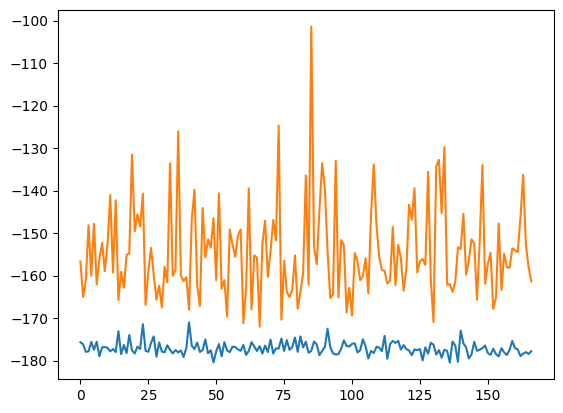

alpha 0.3 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.05184824304935028
1  c = 0.2529391340532123
2  c = 0.21376889785084127
3  c = 0.049242850021030314
4  c = 0.16347204767156714
5  c = 0.046266321936966524
6  c = 0.07298523868330284
7  c = 0.11594503856006243
8  c = 0.28948958889092186
9  c = 0.0909954389771499
10  c = 0.17319521138263477
11  c = 0.06307724053242084
12  c = 0.018607274027982533
13  c = 0.06577708016165242
14  c = 0.28078295434883027
15  c = 0.1855889792054566
16  c = 0.1046438020364191
17  c = 0.04320551789072944
18  c = 0.14863585755184278
19  c = 0.08767469010567959
20  c = 0.09772915530136912
21  c = 0.15682756907447862
22  c = 0.23348309301967343
23  c = 0.09953450322230079
24  c = 0.07772897787435175
25  c = 0.14677575037157922
26  c = 0.15102513994797848
27  c = 0.19555185810762096
28  c = 0.25356863125675777
29  c = 0.05422210287009758
30  c = 0.08144398896225649
31  c = 0.04195482389959269
32  c = 0.19768150169595647
33  c = 0.05169613877697882
34  c = 0.019792360038457444
35  c = 0.14072353866864032
36

97  c = 0.29649256804626567
98  c = 0.07426741897378726
99  c = 0.0034108935951333796
 
実環境方策rollout vs Sim環境方策rollout


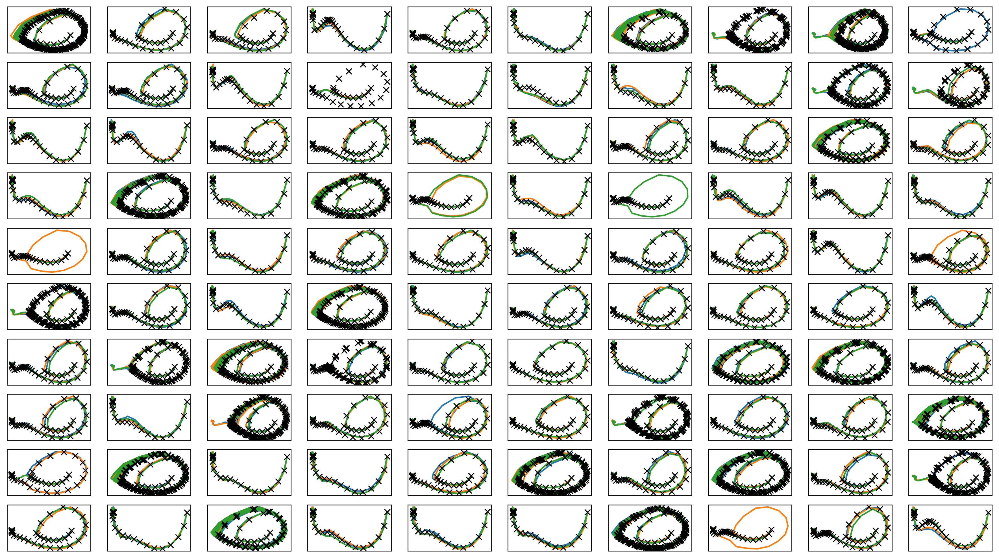

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

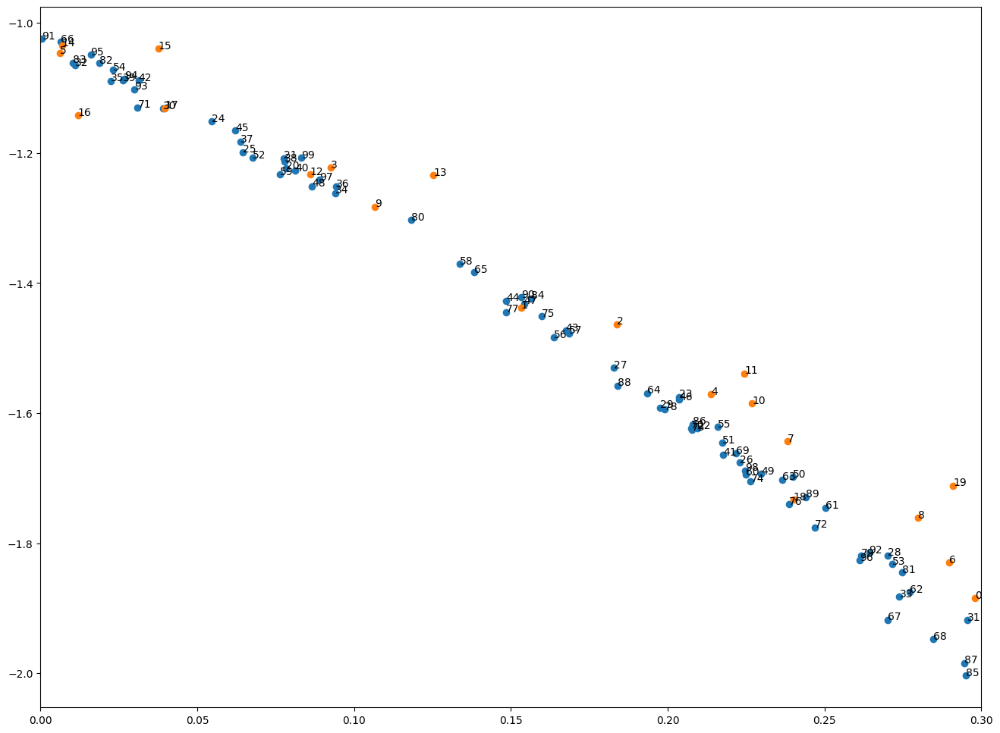

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-04-04 02:18:48.220831


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.1291416903324736
c = 0.04113112631306058
c = 0.17125202577141815
c = 0.21655731560520555
c = 0.059042082329986964
c = 0.2626902348210787
c = 0.2819918983400506
c = 0.2038275886670018
c = 0.2913163677031838
c = 0.2110655093748364
c = 0.1283572662870152
c = 0.0183477364851778
c = 0.17157822056335734
1  c = 0.2508005840107313
c = 0.11023634107649734
c = 0.17900302857242284
c = 0.2523260643595241
c = 0.06447531415786245
c = 0.14288262635126792
c = 0.2805254509335254
c = 0.20578259088291026
c = 0.1946622902209769
c = 0.2200925309038579
2  c = 0.06796860212693684
c = 0.1933800856311533
c = 0.12552678627528377
c = 0.06115402698841865
c = 0.22844931029942506
c = 0.26170772211176835
c = 0.10485382596289561
c = 0.20099666722493298
c = 0.23390988265757606
c = 0.07331758819729203
c = 0.03791677817306231
c = 0.19195498343581271
c = 0.06689745682612563
c = 0.2610548169126173
3  c = 0.29545643762616053
c = 0.225321800269851
c = 0.020682244513117752
c = 0.27340072917331026
c = 0.0225243193721

c = 0.19542432974473403
c = 0.1525121607683708
c = 0.1508023756740068
c = 0.001066179099139841
c = 0.21172272022099234
39  c = 0.1939547116737133
c = 0.211044350028902
c = 0.05094401816172543
c = 0.030442474355693114
c = 0.16878244679569904
c = 0.18396426817076242
c = 0.06283336843175953
c = 0.15698364978733217
c = 0.26833200457066475
c = 0.1789586352072164
c = 0.018639526806702333
c = 0.16748652908720477
c = 0.057564925425216705
c = 0.19063831395663497
c = 0.250983661590116
40  c = 0.05339204151791144
c = 0.12150705564738072
c = 0.25840082339546033
c = 0.22877884309539606
c = 0.025595563260796515
c = 0.29914268553254225
41  c = 0.15096029568742314
c = 0.28268754023907156
c = 0.039958764422120915
c = 0.004757557112478006
c = 0.05231533879955717
c = 0.2646314414140453
c = 0.2191277988927236
42  c = 0.05264991371438168
c = 0.17942692708258792
c = 0.27082192327828075
c = 0.15935718007188165
c = 0.1798914566182179
c = 0.026692816084455683
43  c = 0.058762002908849226
c = 0.1635743759852148

c = 0.18580259164029808
c = 0.1996634557100391
c = 0.2852305532851172
c = 0.07899928442219838
c = 0.13276044286715008
c = 0.03702735521816904
79  c = 0.2593323222159236
c = 0.28784114909062714
c = 0.27083544612114485
c = 0.021551801411887183
c = 0.25755530178639063
c = 0.049584015567754144
c = 0.05961360975000993
c = 0.004413370592018806
c = 0.22260457830804847
c = 0.21241897431166162
80  c = 0.012724063268569208
c = 0.15433342309009507
c = 0.22846136907952752
c = 0.09216358181194302
c = 0.19608010761327438
c = 0.18822038028969096
c = 0.2567373162468605
81  c = 0.21946246487445947
c = 0.2232857329494569
c = 0.2476686717660744
c = 0.2568522056659882
c = 0.22311697110571216
c = 0.2936607591937887
c = 0.1690751223581259
c = 0.14679871720618445
c = 0.18590867496795738
c = 0.23739816436217037
c = 0.20986211995829387
82  c = 0.2966514059093321
c = 0.18989905236020732
c = 0.28016295549063924
c = 0.20581669003217598
c = 0.22233385695941357
c = 0.15076142274522158
c = 0.08243858149457696
c = 0.

In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.12601  validloss 0.17527±0.00000  bestvalidloss 0.17527  last_update 0
train: iter 1  trainloss 0.12279  validloss 0.15496±0.00000  bestvalidloss 0.15496  last_update 0
train: iter 2  trainloss 0.12245  validloss 0.15498±0.00000  bestvalidloss 0.15496  last_update 1
train: iter 3  trainloss 0.12258  validloss 0.15842±0.00000  bestvalidloss 0.15496  last_update 2
train: iter 4  trainloss 0.11988  validloss 0.15827±0.00000  bestvalidloss 0.15496  last_update 3
train: iter 5  trainloss 0.12008  validloss 0.15413±0.00000  bestvalidloss 0.15413  last_update 0
train: iter 6  trainloss 0.11865  validloss 0.15547±0.00000  bestvalidloss 0.15413  last_update 1
train: iter 7  trainloss 0.11894  validloss 0.15946±0.00000  bestvalidloss 0.15413  last_update 2
train: iter 8  trainloss 0.11869  validloss 0.15812±0.00000  bestvalidloss 0.15413  last_update 3
train: iter 9  trainloss 0.11908  validloss 0.15475±0.00000  bestvalidloss 0.15413  last_update 4
train: iter 10  trai

train: iter 84  trainloss 0.11248  validloss 0.14942±0.00000  bestvalidloss 0.14942  last_update 0
train: iter 85  trainloss 0.11443  validloss 0.15147±0.00000  bestvalidloss 0.14942  last_update 1
train: iter 86  trainloss 0.11260  validloss 0.15295±0.00000  bestvalidloss 0.14942  last_update 2
train: iter 87  trainloss 0.11222  validloss 0.15076±0.00000  bestvalidloss 0.14942  last_update 3
train: iter 88  trainloss 0.11201  validloss 0.15089±0.00000  bestvalidloss 0.14942  last_update 4
train: iter 89  trainloss 0.11263  validloss 0.15083±0.00000  bestvalidloss 0.14942  last_update 5
train: iter 90  trainloss 0.11278  validloss 0.15109±0.00000  bestvalidloss 0.14942  last_update 6
train: iter 91  trainloss 0.11190  validloss 0.15223±0.00000  bestvalidloss 0.14942  last_update 7
train: iter 92  trainloss 0.11174  validloss 0.15016±0.00000  bestvalidloss 0.14942  last_update 8
train: iter 93  trainloss 0.11106  validloss 0.15116±0.00000  bestvalidloss 0.14942  last_update 9
train: ite

train: iter 166  trainloss 0.10983  validloss 0.14986±0.00000  bestvalidloss 0.14919  last_update 5
train: iter 167  trainloss 0.10871  validloss 0.14937±0.00000  bestvalidloss 0.14919  last_update 6
train: iter 168  trainloss 0.10952  validloss 0.15125±0.00000  bestvalidloss 0.14919  last_update 7
train: iter 169  trainloss 0.10965  validloss 0.15122±0.00000  bestvalidloss 0.14919  last_update 8
train: iter 170  trainloss 0.11183  validloss 0.15247±0.00000  bestvalidloss 0.14919  last_update 9
train: iter 171  trainloss 0.10958  validloss 0.15354±0.00000  bestvalidloss 0.14919  last_update 10
train: iter 172  trainloss 0.10870  validloss 0.15112±0.00000  bestvalidloss 0.14919  last_update 11
train: iter 173  trainloss 0.10937  validloss 0.15124±0.00000  bestvalidloss 0.14919  last_update 12
train: iter 174  trainloss 0.10967  validloss 0.15209±0.00000  bestvalidloss 0.14919  last_update 13
train: iter 175  trainloss 0.10883  validloss 0.14975±0.00000  bestvalidloss 0.14919  last_updat

train: iter 249  trainloss 0.10633  validloss 0.15304±0.00000  bestvalidloss 0.14891  last_update 65
train: iter 250  trainloss 0.10628  validloss 0.15081±0.00000  bestvalidloss 0.14891  last_update 66
train: iter 251  trainloss 0.10721  validloss 0.15287±0.00000  bestvalidloss 0.14891  last_update 67
train: iter 252  trainloss 0.10751  validloss 0.15145±0.00000  bestvalidloss 0.14891  last_update 68
train: iter 253  trainloss 0.10736  validloss 0.15107±0.00000  bestvalidloss 0.14891  last_update 69
train: iter 254  trainloss 0.10958  validloss 0.15441±0.00000  bestvalidloss 0.14891  last_update 70
train: iter 255  trainloss 0.10777  validloss 0.14984±0.00000  bestvalidloss 0.14891  last_update 71
train: iter 256  trainloss 0.10658  validloss 0.15009±0.00000  bestvalidloss 0.14891  last_update 72
train: iter 257  trainloss 0.10700  validloss 0.15218±0.00000  bestvalidloss 0.14891  last_update 73
train: iter 258  trainloss 0.10826  validloss 0.15413±0.00000  bestvalidloss 0.14891  last_

In [44]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -171.9422337567806
valid_loss:  -281.21895453929903
train_loss:  -159.00448607206346
valid_loss:  -148.51068259239196


1e-08 1000.0


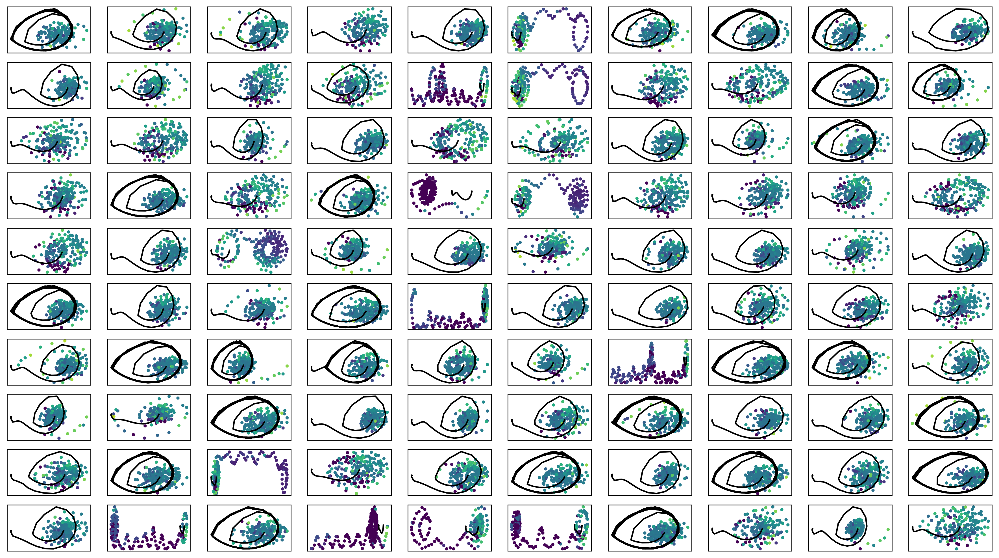

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -155.19525  validloss -147.61186±0.00000  bestvalidloss -147.61186  last_update 0
train: iter 1  trainloss -156.41750  validloss -153.58883±0.00000  bestvalidloss -153.58883  last_update 0
train: iter 2  trainloss -150.12442  validloss -145.16770±0.00000  bestvalidloss -153.58883  last_update 1
train: iter 3  trainloss -159.34336  validloss -160.17386±0.00000  bestvalidloss -160.17386  last_update 0
train: iter 4  trainloss -155.33628  validloss -149.36756±0.00000  bestvalidloss -160.17386  last_update 1
train: iter 5  trainloss -155.59178  validloss -125.45583±0.00000  bestvalidloss -160.17386  last_update 2
train: iter 6  trainloss -158.39902  validloss -135.78565±0.00000  bestvalidloss -160.17386  last_update 3
train: iter 7  trainloss -158.87828  validloss -138.18145±0.00000  bestvalidloss -160.17386  last_update 4
train: iter 8  trainloss -146.71869  validloss -131.10452±0.00000  bestvalidloss -160.17386  last_update 5
train: it

train: iter 76  trainloss -157.80203  validloss -157.83734±0.00000  bestvalidloss -164.61105  last_update 29
train: iter 77  trainloss -159.32888  validloss -162.38191±0.00000  bestvalidloss -164.61105  last_update 30
train: iter 78  trainloss -158.33222  validloss -131.94068±0.00000  bestvalidloss -164.61105  last_update 31
train: iter 79  trainloss -158.18955  validloss -146.25414±0.00000  bestvalidloss -164.61105  last_update 32
train: iter 80  trainloss -151.06552  validloss -119.71348±0.00000  bestvalidloss -164.61105  last_update 33
train: iter 81  trainloss -152.92965  validloss -149.25810±0.00000  bestvalidloss -164.61105  last_update 34
train: iter 82  trainloss -157.05288  validloss -159.62295±0.00000  bestvalidloss -164.61105  last_update 35
train: iter 83  trainloss -156.48695  validloss -128.13558±0.00000  bestvalidloss -164.61105  last_update 36
train: iter 84  trainloss -152.67764  validloss -139.76800±0.00000  bestvalidloss -164.61105  last_update 37
train: iter 85  tra

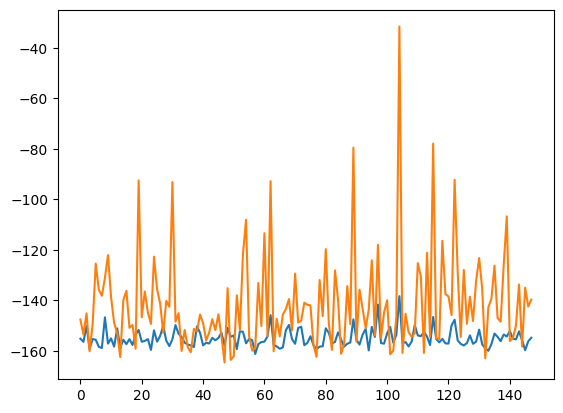

train_weighted_vae: enc
train: iter 0  trainloss -155.04897  validloss -129.69852±0.00000  bestvalidloss -129.69852  last_update 0
train: iter 1  trainloss -154.29205  validloss -147.40833±0.00000  bestvalidloss -147.40833  last_update 0
train: iter 2  trainloss -154.44489  validloss -142.19133±0.00000  bestvalidloss -147.40833  last_update 1
train: iter 3  trainloss -152.74640  validloss -135.86932±0.00000  bestvalidloss -147.40833  last_update 2
train: iter 4  trainloss -154.89539  validloss -150.27314±0.00000  bestvalidloss -150.27314  last_update 0
train: iter 5  trainloss -151.41970  validloss -138.33300±0.00000  bestvalidloss -150.27314  last_update 1
train: iter 6  trainloss -153.15060  validloss -98.86136±0.00000  bestvalidloss -150.27314  last_update 2
train: iter 7  trainloss -155.64973  validloss -143.77617±0.00000  bestvalidloss -150.27314  last_update 3
train: iter 8  trainloss -155.50621  validloss -128.45893±0.00000  bestvalidloss -150.27314  last_update 4
train: iter 9 

train: iter 77  trainloss -152.37659  validloss -132.22057±0.00000  bestvalidloss -160.82623  last_update 61
train: iter 78  trainloss -154.76516  validloss -135.96254±0.00000  bestvalidloss -160.82623  last_update 62
train: iter 79  trainloss -154.93666  validloss -150.62121±0.00000  bestvalidloss -160.82623  last_update 63
train: iter 80  trainloss -155.29304  validloss -118.85247±0.00000  bestvalidloss -160.82623  last_update 64
train: iter 81  trainloss -154.57798  validloss -141.39889±0.00000  bestvalidloss -160.82623  last_update 65
train: iter 82  trainloss -153.83932  validloss -137.59912±0.00000  bestvalidloss -160.82623  last_update 66
train: iter 83  trainloss -154.07863  validloss -142.49798±0.00000  bestvalidloss -160.82623  last_update 67
train: iter 84  trainloss -156.78593  validloss -149.90554±0.00000  bestvalidloss -160.82623  last_update 68
train: iter 85  trainloss -156.57373  validloss -140.04403±0.00000  bestvalidloss -160.82623  last_update 69
train: iter 86  tra

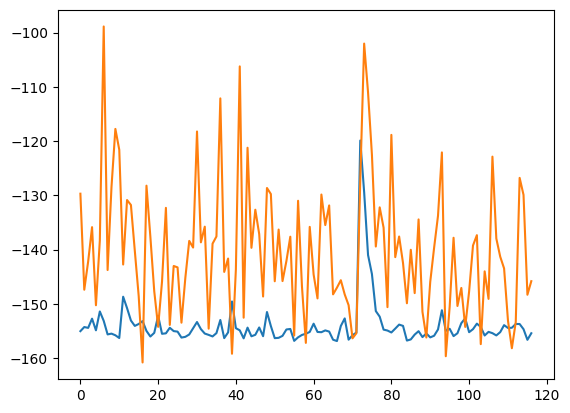

train_weighted_vae: dec
train: iter 0  trainloss -156.17984  validloss -137.33256±0.00000  bestvalidloss -137.33256  last_update 0
train: iter 1  trainloss -158.39468  validloss -144.19700±0.00000  bestvalidloss -144.19700  last_update 0
train: iter 2  trainloss -157.19258  validloss -138.69159±0.00000  bestvalidloss -144.19700  last_update 1
train: iter 3  trainloss -155.92661  validloss -143.76651±0.00000  bestvalidloss -144.19700  last_update 2
train: iter 4  trainloss -158.57627  validloss -140.04309±0.00000  bestvalidloss -144.19700  last_update 3
train: iter 5  trainloss -155.79084  validloss -151.02812±0.00000  bestvalidloss -151.02812  last_update 0
train: iter 6  trainloss -155.98995  validloss -135.75354±0.00000  bestvalidloss -151.02812  last_update 1
train: iter 7  trainloss -154.57001  validloss -133.46466±0.00000  bestvalidloss -151.02812  last_update 2
train: iter 8  trainloss -157.37209  validloss -148.85558±0.00000  bestvalidloss -151.02812  last_update 3
train: iter 9

train: iter 77  trainloss -159.39829  validloss -131.50345±0.00000  bestvalidloss -159.60292  last_update 43
train: iter 78  trainloss -157.04383  validloss -144.08992±0.00000  bestvalidloss -159.60292  last_update 44
train: iter 79  trainloss -158.63954  validloss -130.17180±0.00000  bestvalidloss -159.60292  last_update 45
train: iter 80  trainloss -153.19288  validloss -136.06062±0.00000  bestvalidloss -159.60292  last_update 46
train: iter 81  trainloss -158.40982  validloss -136.18234±0.00000  bestvalidloss -159.60292  last_update 47
train: iter 82  trainloss -154.06170  validloss -140.58188±0.00000  bestvalidloss -159.60292  last_update 48
train: iter 83  trainloss -156.69468  validloss -91.36287±0.00000  bestvalidloss -159.60292  last_update 49
train: iter 84  trainloss -159.09904  validloss -128.79125±0.00000  bestvalidloss -159.60292  last_update 50
train: iter 85  trainloss -159.35402  validloss -135.69014±0.00000  bestvalidloss -159.60292  last_update 51
train: iter 86  trai

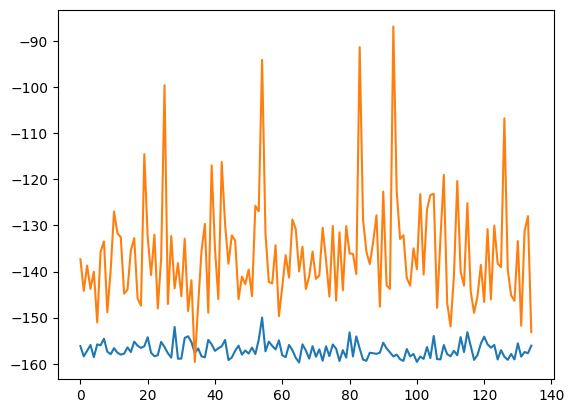

alpha 0.3 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.09148385821339329
1  c = 0.19677822148600232
2  c = 0.2273337713615298
3  c = 0.0792087102897038
4  c = 0.20555015683793504
5  c = 0.19176888264455483
6  c = 0.18267177166236348
7  c = 0.24402681472422738
8  c = 0.29423821451915294
9  c = 0.023790697391420857
10  c = 0.2020342306054244
11  c = 0.20684945695371632
12  c = 0.02913033904059362
13  c = 0.2978413218792869
14  c = 0.2747758512269614
15  c = 0.006994386212546632
16  c = 0.03535076766836032
17  c = 0.13544357115059946
18  c = 0.18210899671614134
19  c = 0.13599612539277364
20  c = 0.1247768865398707
21  c = 0.23814998276729366
22  c = 0.015975780921363047
23  c = 0.09585999466227044
24  c = 0.052946875921209564
25  c = 0.2663765731372429
26  c = 0.019230877798626898
27  c = 0.16076296690239142
28  c = 0.11395892260656697
29  c = 0.14109895294644367
30  c = 0.04506000808804537
31  c = 0.19249165795189413
32  c = 0.1524980033145635
33  c = 0.019390904569831568
34  c = 0.17628406257221338
35  c = 0.12850286406606606
36  

97  c = 0.2874548115021382
98  c = 0.05520951816998426
99  c = 0.1600013164038132
 
実環境方策rollout vs Sim環境方策rollout


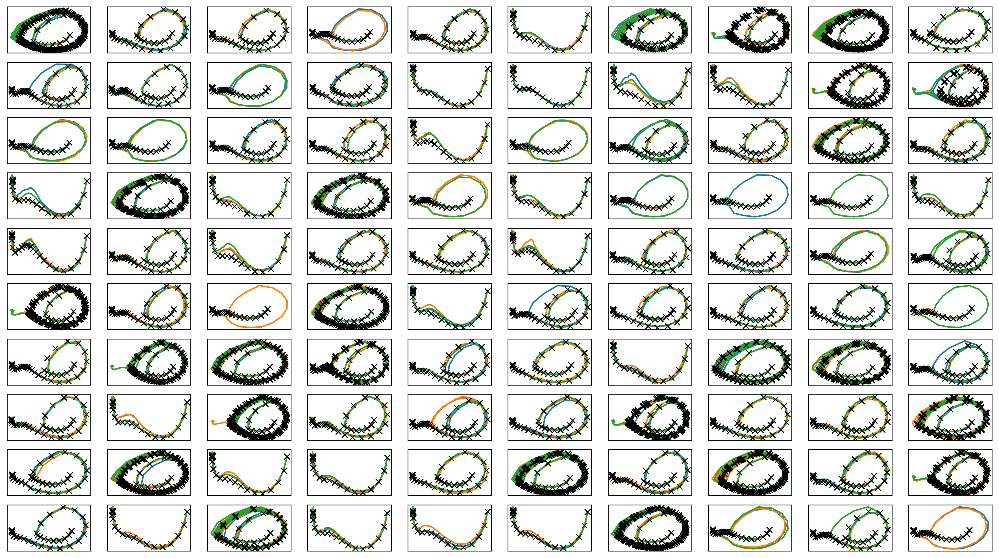

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
plt.savefig(figfilenamehead+"joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

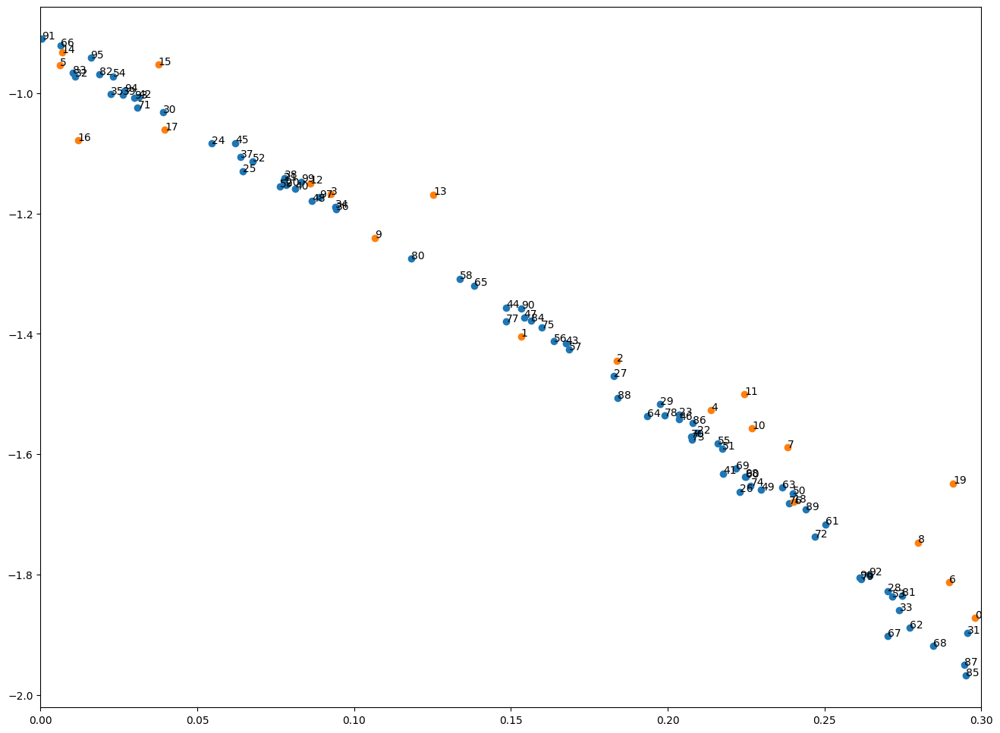

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
plt.savefig(figfilenamehead+"damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-04-04 02:21:52.039615


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.02086387098206499
c = 0.010841425089774991
c = 0.19952530784024688
c = 0.13236779507673982
c = 0.027383800804752046
c = 0.14859421135292844
c = 0.008492157920843079
c = 0.06272295209971333
c = 0.06320585566195969
c = 0.09557938217925227
1  c = 0.05355934967882665
c = 0.25272044250494147
c = 0.10495840319545593
c = 0.15041436943832429
c = 0.21583365041233932
c = 0.04835363212909542
c = 0.13361158844159823
c = 0.19696429710976768
c = 0.0440683099094029
2  c = 0.18516227389484946
c = 0.016589603945366516
c = 0.08019316480839411
c = 0.15594445693933306
c = 0.01091022441269056
c = 0.0982906633429967
c = 0.12127372931560455
3  c = 0.15066683174515602
c = 0.12940211359665266
c = 0.005909638108446791
c = 0.1842423727004404
c = 0.14986092567860695
c = 0.08783565319428578
c = 0.13180667849292102
c = 0.1596390141406685
4  c = 0.13768198008353655
c = 0.24777067313955703
c = 0.17363351075424804
c = 0.008048397716354882
c = 0.16908084956331082
c = 0.1618174444593938
c = 0.26228129500680486


c = 0.14841286859714634
38  c = 0.040019066833930306
c = 0.03280545320881882
c = 0.09632354297690514
39  c = 0.269953842749464
c = 0.04033404150413065
c = 0.15821912013972741
c = 0.08641963761057107
c = 0.13851721483558074
c = 0.2475939017036386
c = 0.267436619608427
40  c = 0.14341513800415973
c = 0.2710748764864809
c = 0.031465914791562695
c = 0.20796462526146656
c = 0.06648608115111661
c = 0.15542868300508286
c = 0.23758423721468513
41  c = 0.1052409433250557
c = 0.08104611892500675
c = 0.17610091424193391
c = 0.29012332260432483
c = 0.2577968403583737
c = 0.014194820703049081
42  c = 0.2587599288969001
c = 0.2537616430690584
c = 0.06507518026106124
c = 0.056421706479945766
c = 0.037207994124354146
c = 0.23166334701344585
c = 0.10169173922102016
c = 0.27272397959300737
c = 0.08015461345560763
c = 0.044365762800049564
43  c = 0.14657773533857332
c = 0.141644762505809
c = 0.2505782142276811
c = 0.25547140206991664
44  c = 0.14237146220549493
c = 0.05175016618622181
c = 0.1085666273456

81  c = 0.16456168989985395
c = 0.20626851601193866
c = 0.26620720813671744
c = 0.06766094903759702
c = 0.10367971020407628
c = 0.059909812565362014
82  c = 0.010517973113360378
c = 0.20825082061847874
c = 0.22777840390455306
c = 0.20477909024649418
c = 0.17134435558594963
c = 0.1281793671623723
c = 0.29976425936496703
c = 0.2092049156631375
c = 0.16872948976529045
c = 0.08646509200145648
c = 0.17251462247690771
c = 0.09637075696810038
83  c = 0.09755674105449393
c = 0.27538558871246066
c = 0.130644685277917
c = 0.2844779079305362
c = 0.18927005119838367
c = 0.24603443927635196
c = 0.24666374748543185
c = 0.019521535646287013
c = 0.034351991196242236
84  c = 0.04651426466498419
c = 0.2542805006845653
c = 0.013527858392407976
c = 0.16013105984167406
c = 0.16617168850058772
c = 0.25217207290676963
c = 0.021301693778758134
c = 0.07172914782326507
c = 0.0446228854644433
c = 0.06601682859531419
c = 0.07582324685686527
c = 0.13772334898156385
c = 0.05463929731200732
c = 0.06587693731537393
8

In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.12244  validloss 0.15978±0.00000  bestvalidloss 0.15978  last_update 0
train: iter 1  trainloss 0.11881  validloss 0.14860±0.00000  bestvalidloss 0.14860  last_update 0
train: iter 2  trainloss 0.11785  validloss 0.14652±0.00000  bestvalidloss 0.14652  last_update 0
train: iter 3  trainloss 0.11808  validloss 0.14750±0.00000  bestvalidloss 0.14652  last_update 1
train: iter 4  trainloss 0.11588  validloss 0.14788±0.00000  bestvalidloss 0.14652  last_update 2
train: iter 5  trainloss 0.11643  validloss 0.14845±0.00000  bestvalidloss 0.14652  last_update 3
train: iter 6  trainloss 0.11671  validloss 0.14697±0.00000  bestvalidloss 0.14652  last_update 4
train: iter 7  trainloss 0.11532  validloss 0.14827±0.00000  bestvalidloss 0.14652  last_update 5
train: iter 8  trainloss 0.11703  validloss 0.14792±0.00000  bestvalidloss 0.14652  last_update 6
train: iter 9  trainloss 0.11604  validloss 0.15016±0.00000  bestvalidloss 0.14652  last_update 7
train: iter 10  trai

train: iter 83  trainloss 0.10993  validloss 0.15093±0.00000  bestvalidloss 0.14461  last_update 71
train: iter 84  trainloss 0.10934  validloss 0.15071±0.00000  bestvalidloss 0.14461  last_update 72
train: iter 85  trainloss 0.10969  validloss 0.14725±0.00000  bestvalidloss 0.14461  last_update 73
train: iter 86  trainloss 0.10950  validloss 0.15044±0.00000  bestvalidloss 0.14461  last_update 74
train: iter 87  trainloss 0.10931  validloss 0.14921±0.00000  bestvalidloss 0.14461  last_update 75
train: iter 88  trainloss 0.11041  validloss 0.14979±0.00000  bestvalidloss 0.14461  last_update 76
train: iter 89  trainloss 0.10989  validloss 0.15055±0.00000  bestvalidloss 0.14461  last_update 77
train: iter 90  trainloss 0.11118  validloss 0.14753±0.00000  bestvalidloss 0.14461  last_update 78
train: iter 91  trainloss 0.11052  validloss 0.15135±0.00000  bestvalidloss 0.14461  last_update 79
train: iter 92  trainloss 0.10916  validloss 0.15090±0.00000  bestvalidloss 0.14461  last_update 80


In [55]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -177.88031982183455
valid_loss:  -324.4465056991577
train_loss:  -174.08253051042556
valid_loss:  -166.1533921170235


1e-08 1000.0


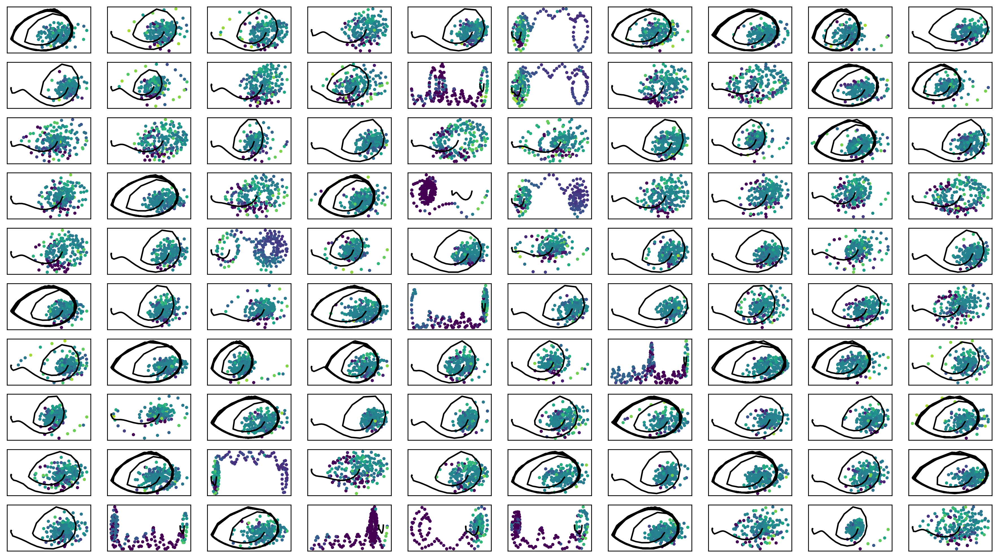

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -169.49252  validloss -164.97970±0.00000  bestvalidloss -164.97970  last_update 0
train: iter 1  trainloss -173.05867  validloss -177.41625±0.00000  bestvalidloss -177.41625  last_update 0
train: iter 2  trainloss -168.26316  validloss -162.30700±0.00000  bestvalidloss -177.41625  last_update 1
train: iter 3  trainloss -177.30133  validloss -180.83074±0.00000  bestvalidloss -180.83074  last_update 0
train: iter 4  trainloss -171.52457  validloss -167.17438±0.00000  bestvalidloss -180.83074  last_update 1
train: iter 5  trainloss -176.85268  validloss -168.13738±0.00000  bestvalidloss -180.83074  last_update 2
train: iter 6  trainloss -173.04917  validloss -148.51840±0.00000  bestvalidloss -180.83074  last_update 3
train: iter 7  trainloss -166.61826  validloss -164.27304±0.00000  bestvalidloss -180.83074  last_update 4
train: iter 8  trainloss -175.66981  validloss -146.29216±0.00000  bestvalidloss -180.83074  last_update 5
train: it

train: iter 76  trainloss -173.86413  validloss -175.06564±0.00000  bestvalidloss -183.78427  last_update 65
train: iter 77  trainloss -168.80447  validloss -161.55094±0.00000  bestvalidloss -183.78427  last_update 66
train: iter 78  trainloss -173.14615  validloss -150.96257±0.00000  bestvalidloss -183.78427  last_update 67
train: iter 79  trainloss -171.72051  validloss -164.98634±0.00000  bestvalidloss -183.78427  last_update 68
train: iter 80  trainloss -173.68720  validloss -174.78196±0.00000  bestvalidloss -183.78427  last_update 69
train: iter 81  trainloss -164.73405  validloss -159.85269±0.00000  bestvalidloss -183.78427  last_update 70
train: iter 82  trainloss -173.87704  validloss -167.43466±0.00000  bestvalidloss -183.78427  last_update 71
train: iter 83  trainloss -175.16439  validloss -170.63592±0.00000  bestvalidloss -183.78427  last_update 72
train: iter 84  trainloss -173.50310  validloss -141.03041±0.00000  bestvalidloss -183.78427  last_update 73
train: iter 85  tra

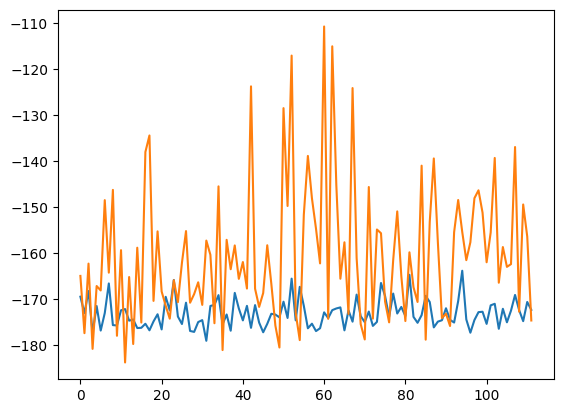

train_weighted_vae: enc
train: iter 0  trainloss -178.01565  validloss -160.94846±0.00000  bestvalidloss -160.94846  last_update 0
train: iter 1  trainloss -176.06126  validloss -170.13986±0.00000  bestvalidloss -170.13986  last_update 0
train: iter 2  trainloss -177.65728  validloss -172.54263±0.00000  bestvalidloss -172.54263  last_update 0
train: iter 3  trainloss -178.16433  validloss -178.80481±0.00000  bestvalidloss -178.80481  last_update 0
train: iter 4  trainloss -178.67111  validloss -178.92275±0.00000  bestvalidloss -178.92275  last_update 0
train: iter 5  trainloss -178.99137  validloss -158.59479±0.00000  bestvalidloss -178.92275  last_update 1
train: iter 6  trainloss -176.04236  validloss -157.70571±0.00000  bestvalidloss -178.92275  last_update 2
train: iter 7  trainloss -175.86072  validloss -162.16151±0.00000  bestvalidloss -178.92275  last_update 3
train: iter 8  trainloss -175.37025  validloss -179.78985±0.00000  bestvalidloss -179.78985  last_update 0
train: iter 9

train: iter 76  trainloss -171.98419  validloss -178.07770±0.00000  bestvalidloss -179.78985  last_update 68
train: iter 77  trainloss -177.79518  validloss -152.70675±0.00000  bestvalidloss -179.78985  last_update 69
train: iter 78  trainloss -174.35266  validloss -160.38212±0.00000  bestvalidloss -179.78985  last_update 70
train: iter 79  trainloss -169.49648  validloss -137.55807±0.00000  bestvalidloss -179.78985  last_update 71
train: iter 80  trainloss -175.12493  validloss -162.98986±0.00000  bestvalidloss -179.78985  last_update 72
train: iter 81  trainloss -178.36083  validloss -174.14814±0.00000  bestvalidloss -179.78985  last_update 73
train: iter 82  trainloss -178.62395  validloss -160.83007±0.00000  bestvalidloss -179.78985  last_update 74
train: iter 83  trainloss -178.83372  validloss -145.42461±0.00000  bestvalidloss -179.78985  last_update 75
train: iter 84  trainloss -177.75732  validloss -168.24494±0.00000  bestvalidloss -179.78985  last_update 76
train: iter 85  tra

train: iter 151  trainloss -178.61916  validloss -158.73693±0.00000  bestvalidloss -180.37938  last_update 44
train: iter 152  trainloss -179.14863  validloss -165.51908±0.00000  bestvalidloss -180.37938  last_update 45
train: iter 153  trainloss -177.33689  validloss -145.57878±0.00000  bestvalidloss -180.37938  last_update 46
train: iter 154  trainloss -177.35410  validloss -178.58795±0.00000  bestvalidloss -180.37938  last_update 47
train: iter 155  trainloss -176.26599  validloss -117.23919±0.00000  bestvalidloss -180.37938  last_update 48
train: iter 156  trainloss -179.06942  validloss -159.50014±0.00000  bestvalidloss -180.37938  last_update 49
train: iter 157  trainloss -176.97626  validloss -170.05548±0.00000  bestvalidloss -180.37938  last_update 50
train: iter 158  trainloss -177.25369  validloss -149.09861±0.00000  bestvalidloss -180.37938  last_update 51
train: iter 159  trainloss -176.50308  validloss -154.17294±0.00000  bestvalidloss -180.37938  last_update 52
train: ite

train: iter 226  trainloss -178.99236  validloss -174.03342±0.00000  bestvalidloss -183.74626  last_update 61
train: iter 227  trainloss -178.34580  validloss -158.47262±0.00000  bestvalidloss -183.74626  last_update 62
train: iter 228  trainloss -178.07601  validloss -150.51097±0.00000  bestvalidloss -183.74626  last_update 63
train: iter 229  trainloss -176.67395  validloss -154.21467±0.00000  bestvalidloss -183.74626  last_update 64
train: iter 230  trainloss -178.58116  validloss -150.01855±0.00000  bestvalidloss -183.74626  last_update 65
train: iter 231  trainloss -178.11367  validloss -164.15891±0.00000  bestvalidloss -183.74626  last_update 66
train: iter 232  trainloss -176.69199  validloss -152.78381±0.00000  bestvalidloss -183.74626  last_update 67
train: iter 233  trainloss -178.40774  validloss -120.86169±0.00000  bestvalidloss -183.74626  last_update 68
train: iter 234  trainloss -178.07919  validloss -159.66156±0.00000  bestvalidloss -183.74626  last_update 69
train: ite

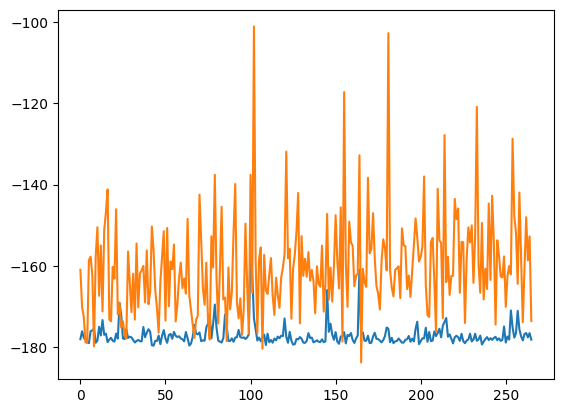

train_weighted_vae: dec
train: iter 0  trainloss -177.32486  validloss -167.46004±0.00000  bestvalidloss -167.46004  last_update 0
train: iter 1  trainloss -173.76946  validloss -155.53876±0.00000  bestvalidloss -167.46004  last_update 1
train: iter 2  trainloss -177.47025  validloss -167.15081±0.00000  bestvalidloss -167.46004  last_update 2
train: iter 3  trainloss -177.47578  validloss -140.47567±0.00000  bestvalidloss -167.46004  last_update 3
train: iter 4  trainloss -178.35761  validloss -165.99048±0.00000  bestvalidloss -167.46004  last_update 4
train: iter 5  trainloss -175.99387  validloss -132.36846±0.00000  bestvalidloss -167.46004  last_update 5
train: iter 6  trainloss -176.22023  validloss -162.55273±0.00000  bestvalidloss -167.46004  last_update 6
train: iter 7  trainloss -175.57973  validloss -135.74445±0.00000  bestvalidloss -167.46004  last_update 7
train: iter 8  trainloss -175.56132  validloss -151.19432±0.00000  bestvalidloss -167.46004  last_update 8
train: iter 9

train: iter 76  trainloss -173.53962  validloss -150.75834±0.00000  bestvalidloss -171.73217  last_update 18
train: iter 77  trainloss -173.62444  validloss -146.95276±0.00000  bestvalidloss -171.73217  last_update 19
train: iter 78  trainloss -179.05033  validloss -156.50672±0.00000  bestvalidloss -171.73217  last_update 20
train: iter 79  trainloss -178.34379  validloss -159.70324±0.00000  bestvalidloss -171.73217  last_update 21
train: iter 80  trainloss -177.21368  validloss -155.00813±0.00000  bestvalidloss -171.73217  last_update 22
train: iter 81  trainloss -177.54593  validloss -162.18392±0.00000  bestvalidloss -171.73217  last_update 23
train: iter 82  trainloss -175.30183  validloss -152.98040±0.00000  bestvalidloss -171.73217  last_update 24
train: iter 83  trainloss -173.89110  validloss -156.71337±0.00000  bestvalidloss -171.73217  last_update 25
train: iter 84  trainloss -176.37161  validloss -159.55981±0.00000  bestvalidloss -171.73217  last_update 26
train: iter 85  tra

train: iter 152  trainloss -177.57082  validloss -161.20043±0.00000  bestvalidloss -171.73217  last_update 94
train: iter 153  trainloss -176.47073  validloss -126.12908±0.00000  bestvalidloss -171.73217  last_update 95
train: iter 154  trainloss -177.45299  validloss -162.56828±0.00000  bestvalidloss -171.73217  last_update 96
train: iter 155  trainloss -174.83799  validloss -159.83938±0.00000  bestvalidloss -171.73217  last_update 97
train: iter 156  trainloss -178.53781  validloss -161.88981±0.00000  bestvalidloss -171.73217  last_update 98
train: iter 157  trainloss -177.51855  validloss -146.43765±0.00000  bestvalidloss -171.73217  last_update 99
train: iter 158  trainloss -178.61478  validloss -148.67519±0.00000  bestvalidloss -171.73217  last_update 100
train: fin


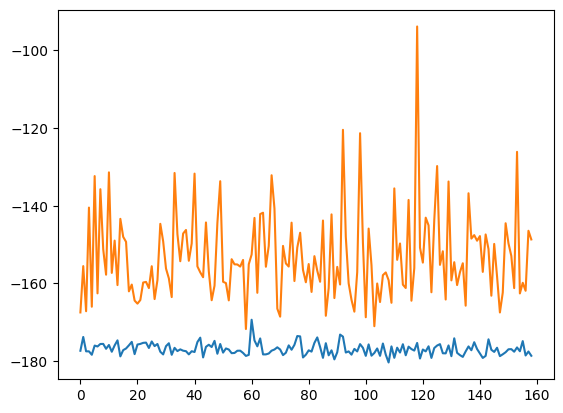

alpha 0.3 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.04431516984872743
1  c = 0.10874927172983001
2  c = 0.21685009479950498
3  c = 0.11434808139118496
4  c = 0.19207418560607595
5  c = 0.0027267896249776103
6  c = 0.08084131396785284
7  c = 0.17566554457815667
8  c = 0.04892792937525887
9  c = 0.02855364593235461
10  c = 0.057193687323415794
11  c = 0.1453220577465025
12  c = 0.24622010383455115
13  c = 0.004289638385519501
14  c = 0.18085585989094402
15  c = 0.2755911585973103
16  c = 0.09562927521152759
17  c = 0.20294890816553027
18  c = 0.1014635702292359
19  c = 0.2116287567127008
20  c = 0.2060594942312159
21  c = 0.2854798523937928
22  c = 0.05596825765204788
23  c = 0.014738224621019112
24  c = 0.08058004729867632
25  c = 0.028079292696132897
26  c = 0.13635539512374065
27  c = 0.13575420538107172
28  c = 0.04618397146287257
29  c = 0.23169298841797006
30  c = 0.1468505863544505
31  c = 0.07499828532381753
32  c = 0.294809867186907
33  c = 0.03308870423444743
34  c = 0.23512460846050545
35  c = 0.04858226493017169
36  c

96  c = 0.061037441613376583
97  c = 0.008475925701318365
98  c = 0.2691039603928158
99  c = 0.2875387588174908
 
実環境方策rollout vs Sim環境方策rollout


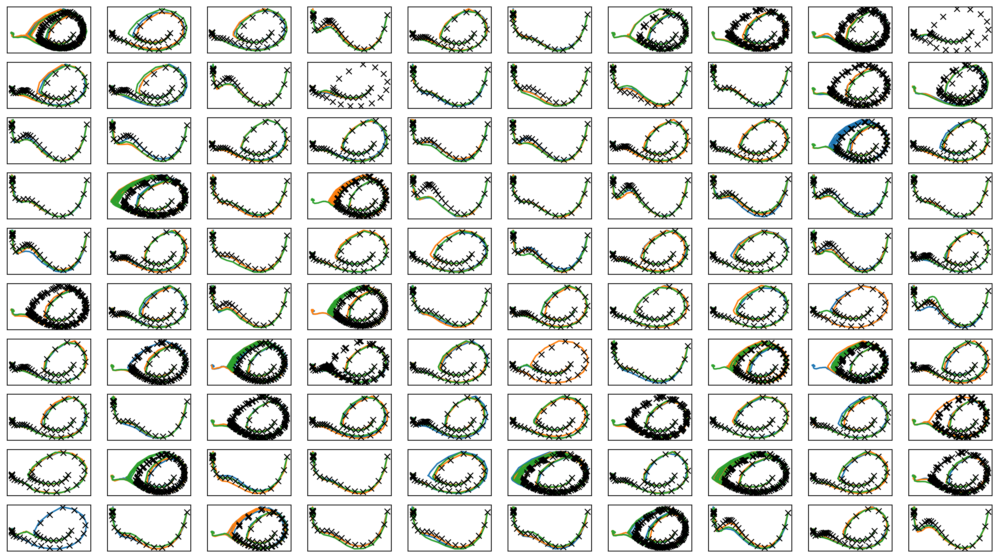

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
plt.savefig(figfilenamehead+"joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

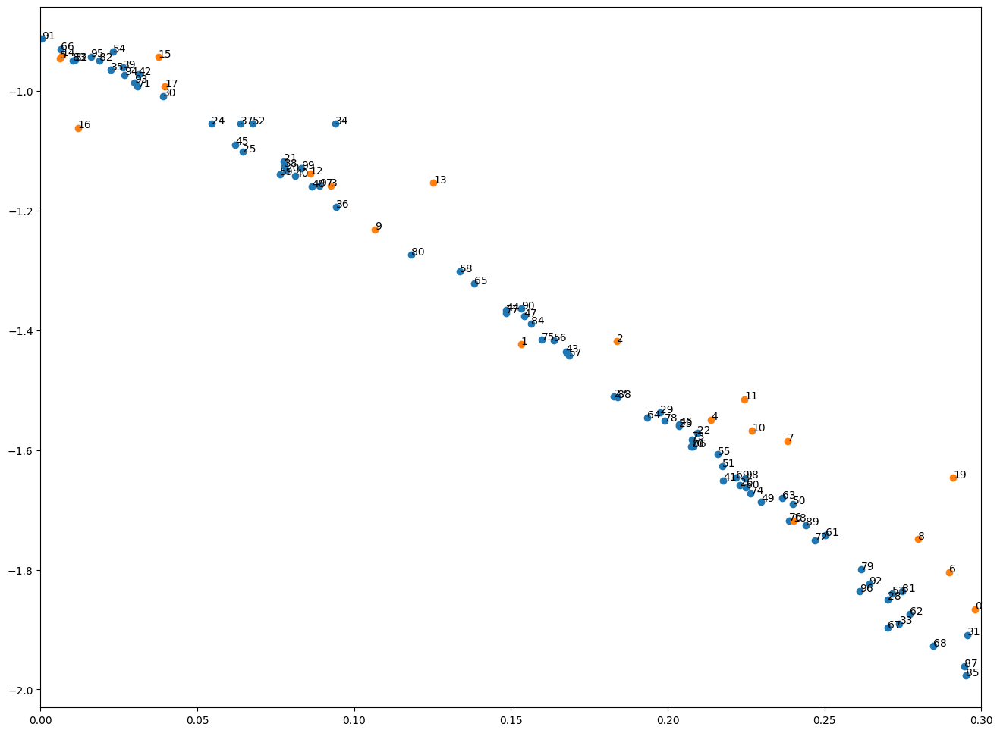

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
plt.savefig(figfilenamehead+"damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-04-04 02:24:59.049956


# 評価関数計算

In [63]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.057530368951230454
c = 0.12786648047122678
c = 0.10691667951159768
c = 0.045502322717939005
c = 0.10682224675591317
c = 0.2875710153960633
c = 0.16864951138662324
c = 0.05744351993381869
c = 0.023253553079672685
c = 0.28779542040917905
1  c = 0.14155072192217943
c = 0.07993687542695642
c = 0.24592709336035884
c = 0.008887647494890337
c = 0.06442433967763651
c = 0.17058263275753857
c = 0.08767514861655869
c = 0.29629215506595197
c = 0.28881875617122715
c = 0.0522162376293258
2  c = 0.03950575663061277
c = 0.13694020238176002
c = 0.19760450351027675
c = 0.2905728262984227
c = 0.1650823544062542
c = 0.2679641124681452
c = 0.01830248096460737
c = 0.016947378652839493
c = 0.23502338437641374
c = 0.18294199633673203
c = 0.060061558392056874
3  c = 0.2855461948951609
c = 0.2160885043888056
c = 0.17445894451405608
c = 0.2083755806907642
c = 0.058697910356699495
c = 0.2176626430183115
c = 0.2708622529635024
c = 0.060365487776253196
c = 0.2542419659312831
c = 0.2355636047057502
4  c = 0

c = 0.08829320291287422
c = 0.10122357974346066
37  c = 0.0985350974099181
c = 0.1024669130023008
c = 0.0011884610174187293
c = 0.07647126980624276
c = 0.05051982071004398
c = 0.06645044648938307
c = 0.2084197340273864
c = 0.24400293900462683
c = 0.2675403313161017
c = 0.28358192401409016
38  c = 0.05700830692546951
c = 0.19563668246424798
c = 0.2837759715895195
c = 0.0692614461420218
c = 0.2762774031526268
c = 0.2687435575460893
c = 0.14963951571892456
c = 0.13023395338659957
c = 0.042525987009671605
39  c = 0.21105262762016266
c = 0.1313262163130439
c = 0.11253843346931965
c = 0.023777195252672023
c = 0.02918953826509424
c = 0.03313632006610634
c = 0.26377071269804975
c = 0.1295850628841528
40  c = 0.0701982365281323
c = 0.04143904821998856
c = 0.2808229651159681
c = 0.028294918015714154
c = 0.07413631667528316
c = 0.09476177902475909
c = 0.24457616207756533
c = 0.028887957450752608
41  c = 0.21939902819856666
c = 0.14692948533374006
c = 0.28516774029563136
c = 0.0982782342997775
c =

c = 0.1244571267501538
c = 0.11838146391583117
c = 0.05326159728997931
c = 0.09742508251669194
c = 0.192763958344266
c = 0.08214901076758566
c = 0.21836170958918646
c = 0.1959375474184201
c = 0.2693390457414262
c = 0.014647396210614816
c = 0.12412823739328056
c = 0.25180037438000824
c = 0.13229236288659277
c = 0.08649488436978682
75  c = 0.07477537881234195
c = 0.29705475135759934
c = 0.025769058572540936
c = 0.2653841061277332
c = 0.013669890310833377
76  c = 0.09633685684410202
c = 0.1763368264860363
c = 0.2927065563293984
c = 0.16108978731510798
c = 0.07088148354134818
c = 0.09398669491170272
c = 0.04567670616124185
c = 0.20545302677025312
c = 0.22166554406358752
c = 0.1522765803943546
c = 0.1634952750502924
c = 0.04661067033107664
c = 0.29028891718953237
c = 0.2831838417714458
c = 0.22228440820976256
c = 0.20552298409620384
c = 0.21503196235158376
77  c = 0.2608208735099767
c = 0.06307720164376777
c = 0.17840654740047943
c = 0.1264350351872475
c = 0.017657751120454167
c = 0.1644389

In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.11400  validloss 0.14707±0.00000  bestvalidloss 0.14707  last_update 0
train: iter 1  trainloss 0.11156  validloss 0.14323±0.00000  bestvalidloss 0.14323  last_update 0
train: iter 2  trainloss 0.11035  validloss 0.14271±0.00000  bestvalidloss 0.14271  last_update 0
train: iter 3  trainloss 0.11047  validloss 0.14562±0.00000  bestvalidloss 0.14271  last_update 1
train: iter 4  trainloss 0.11020  validloss 0.14169±0.00000  bestvalidloss 0.14169  last_update 0
train: iter 5  trainloss 0.10917  validloss 0.14352±0.00000  bestvalidloss 0.14169  last_update 1
train: iter 6  trainloss 0.10901  validloss 0.14191±0.00000  bestvalidloss 0.14169  last_update 2
train: iter 7  trainloss 0.10988  validloss 0.14135±0.00000  bestvalidloss 0.14135  last_update 0
train: iter 8  trainloss 0.11126  validloss 0.14387±0.00000  bestvalidloss 0.14135  last_update 1
train: iter 9  trainloss 0.11019  validloss 0.14167±0.00000  bestvalidloss 0.14135  last_update 2
train: iter 10  trai

train: iter 83  trainloss 0.10476  validloss 0.14269±0.00000  bestvalidloss 0.13759  last_update 6
train: iter 84  trainloss 0.10386  validloss 0.14007±0.00000  bestvalidloss 0.13759  last_update 7
train: iter 85  trainloss 0.10467  validloss 0.14293±0.00000  bestvalidloss 0.13759  last_update 8
train: iter 86  trainloss 0.10397  validloss 0.13792±0.00000  bestvalidloss 0.13759  last_update 9
train: iter 87  trainloss 0.10446  validloss 0.13811±0.00000  bestvalidloss 0.13759  last_update 10
train: iter 88  trainloss 0.10527  validloss 0.13739±0.00000  bestvalidloss 0.13739  last_update 0
train: iter 89  trainloss 0.10467  validloss 0.13965±0.00000  bestvalidloss 0.13739  last_update 1
train: iter 90  trainloss 0.10296  validloss 0.13811±0.00000  bestvalidloss 0.13739  last_update 2
train: iter 91  trainloss 0.10377  validloss 0.13953±0.00000  bestvalidloss 0.13739  last_update 3
train: iter 92  trainloss 0.10393  validloss 0.13938±0.00000  bestvalidloss 0.13739  last_update 4
train: it

train: iter 165  trainloss 0.10235  validloss 0.14290±0.00000  bestvalidloss 0.13711  last_update 41
train: iter 166  trainloss 0.10168  validloss 0.13976±0.00000  bestvalidloss 0.13711  last_update 42
train: iter 167  trainloss 0.10144  validloss 0.14087±0.00000  bestvalidloss 0.13711  last_update 43
train: iter 168  trainloss 0.10074  validloss 0.13844±0.00000  bestvalidloss 0.13711  last_update 44
train: iter 169  trainloss 0.10172  validloss 0.13970±0.00000  bestvalidloss 0.13711  last_update 45
train: iter 170  trainloss 0.10103  validloss 0.14022±0.00000  bestvalidloss 0.13711  last_update 46
train: iter 171  trainloss 0.10179  validloss 0.13928±0.00000  bestvalidloss 0.13711  last_update 47
train: iter 172  trainloss 0.10239  validloss 0.13907±0.00000  bestvalidloss 0.13711  last_update 48
train: iter 173  trainloss 0.10139  validloss 0.14062±0.00000  bestvalidloss 0.13711  last_update 49
train: iter 174  trainloss 0.10062  validloss 0.14065±0.00000  bestvalidloss 0.13711  last_

In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -118.71287190437317
valid_loss:  -177.36663000345231
train_loss:  -171.8986187183857
valid_loss:  -127.1110092520714


In [66]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=100)


train: iter 0  trainloss 4.55898  validloss 4.95823±0.00000  bestvalidloss 4.95823  last_update 0
train: iter 1  trainloss 4.13124  validloss 4.45222±0.00000  bestvalidloss 4.45222  last_update 0
train: iter 2  trainloss 3.77968  validloss 4.04463±0.00000  bestvalidloss 4.04463  last_update 0
train: iter 3  trainloss 3.48017  validloss 3.72631±0.00000  bestvalidloss 3.72631  last_update 0
train: iter 4  trainloss 3.23813  validloss 3.44833±0.00000  bestvalidloss 3.44833  last_update 0
train: iter 5  trainloss 3.01584  validloss 3.20235±0.00000  bestvalidloss 3.20235  last_update 0
train: iter 6  trainloss 2.84139  validloss 2.99593±0.00000  bestvalidloss 2.99593  last_update 0
train: iter 7  trainloss 2.69315  validloss 2.84429±0.00000  bestvalidloss 2.84429  last_update 0
train: iter 8  trainloss 2.55934  validloss 2.69286±0.00000  bestvalidloss 2.69286  last_update 0
train: iter 9  trainloss 2.44000  validloss 2.55456±0.00000  bestvalidloss 2.55456  last_update 0
train: iter 10  trai

train: iter 93  trainloss 0.29893  validloss 0.25631±0.00000  bestvalidloss 0.23692  last_update 4
train: iter 94  trainloss 0.29528  validloss 0.25169±0.00000  bestvalidloss 0.23692  last_update 5
train: iter 95  trainloss 0.30171  validloss 0.25549±0.00000  bestvalidloss 0.23692  last_update 6
train: iter 96  trainloss 0.29696  validloss 0.25441±0.00000  bestvalidloss 0.23692  last_update 7
train: iter 97  trainloss 0.30860  validloss 0.26542±0.00000  bestvalidloss 0.23692  last_update 8
train: iter 98  trainloss 0.29489  validloss 0.26144±0.00000  bestvalidloss 0.23692  last_update 9
train: iter 99  trainloss 0.30122  validloss 0.25481±0.00000  bestvalidloss 0.23692  last_update 10
train: iter 100  trainloss 0.30535  validloss 0.23193±0.00000  bestvalidloss 0.23193  last_update 0
train: iter 101  trainloss 0.30204  validloss 0.25299±0.00000  bestvalidloss 0.23193  last_update 1
train: iter 102  trainloss 0.28027  validloss 0.26012±0.00000  bestvalidloss 0.23193  last_update 2
train:

train: iter 175  trainloss 0.30370  validloss 0.23774±0.00000  bestvalidloss 0.22087  last_update 38
train: iter 176  trainloss 0.29782  validloss 0.25769±0.00000  bestvalidloss 0.22087  last_update 39
train: iter 177  trainloss 0.29335  validloss 0.24985±0.00000  bestvalidloss 0.22087  last_update 40
train: iter 178  trainloss 0.30045  validloss 0.26986±0.00000  bestvalidloss 0.22087  last_update 41
train: iter 179  trainloss 0.29753  validloss 0.25040±0.00000  bestvalidloss 0.22087  last_update 42
train: iter 180  trainloss 0.28682  validloss 0.24318±0.00000  bestvalidloss 0.22087  last_update 43
train: iter 181  trainloss 0.29935  validloss 0.24854±0.00000  bestvalidloss 0.22087  last_update 44
train: iter 182  trainloss 0.30031  validloss 0.26020±0.00000  bestvalidloss 0.22087  last_update 45
train: iter 183  trainloss 0.30583  validloss 0.26081±0.00000  bestvalidloss 0.22087  last_update 46
train: iter 184  trainloss 0.29354  validloss 0.24584±0.00000  bestvalidloss 0.22087  last_

In [67]:
print(iwvi.initial_belief)


Parameter containing:
tensor([-1.4152, -2.2389], requires_grad=True)


In [68]:
train_curve, valid_curve = iwvi.train_penalty(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100)

train: iter 0  trainloss 30.88045  validloss 36.38048±0.00000  bestvalidloss 36.38048  last_update 0
train: iter 1  trainloss 20.39997  validloss 27.29300±0.00000  bestvalidloss 27.29300  last_update 0
train: iter 2  trainloss 14.90901  validloss 23.24525±0.00000  bestvalidloss 23.24525  last_update 0
train: iter 3  trainloss 12.58443  validloss 21.90655±0.00000  bestvalidloss 21.90655  last_update 0
train: iter 4  trainloss 11.25161  validloss 18.96793±0.00000  bestvalidloss 18.96793  last_update 0
train: iter 5  trainloss 10.56306  validloss 20.98450±0.00000  bestvalidloss 18.96793  last_update 1
train: iter 6  trainloss 10.27751  validloss 22.66035±0.00000  bestvalidloss 18.96793  last_update 2
train: iter 7  trainloss 9.95041  validloss 23.55676±0.00000  bestvalidloss 18.96793  last_update 3
train: iter 8  trainloss 9.77098  validloss 22.10431±0.00000  bestvalidloss 18.96793  last_update 4
train: iter 9  trainloss 9.55727  validloss 17.96244±0.00000  bestvalidloss 17.96244  last_up

train: iter 82  trainloss 7.46491  validloss 23.70770±0.00000  bestvalidloss 17.45490  last_update 71
train: iter 83  trainloss 7.53860  validloss 22.03672±0.00000  bestvalidloss 17.45490  last_update 72
train: iter 84  trainloss 7.31916  validloss 19.09291±0.00000  bestvalidloss 17.45490  last_update 73
train: iter 85  trainloss 7.49456  validloss 23.07820±0.00000  bestvalidloss 17.45490  last_update 74
train: iter 86  trainloss 7.35804  validloss 22.80827±0.00000  bestvalidloss 17.45490  last_update 75
train: iter 87  trainloss 7.38578  validloss 20.57492±0.00000  bestvalidloss 17.45490  last_update 76
train: iter 88  trainloss 7.50881  validloss 21.94748±0.00000  bestvalidloss 17.45490  last_update 77
train: iter 89  trainloss 7.43716  validloss 22.61354±0.00000  bestvalidloss 17.45490  last_update 78
train: iter 90  trainloss 7.42316  validloss 22.86092±0.00000  bestvalidloss 17.45490  last_update 79
train: iter 91  trainloss 7.34266  validloss 22.31922±0.00000  bestvalidloss 17.45

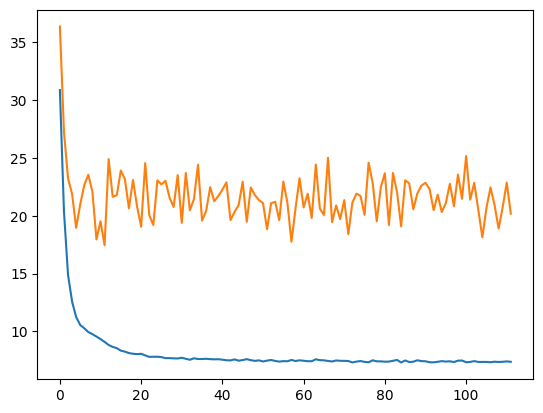

In [69]:
plt.plot(train_curve)
plt.plot(valid_curve)

In [70]:
iwvi.save()

In [71]:
loss_array = np.array(loss_list)

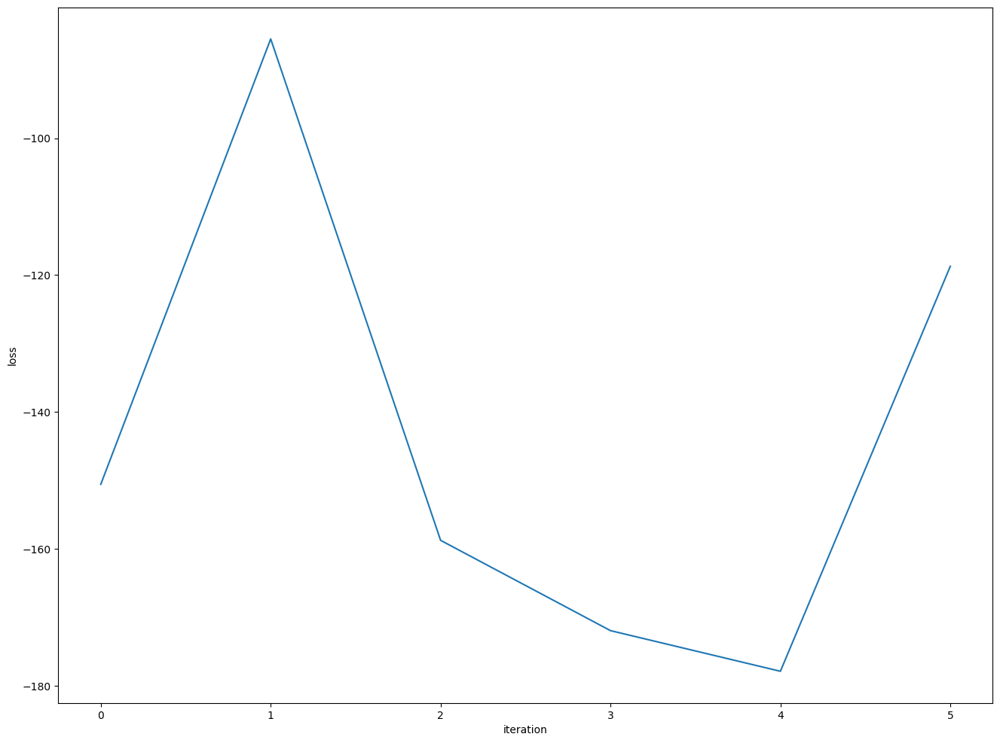

In [72]:
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.png")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.eps")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

Text(0, 0.5, 'loss')

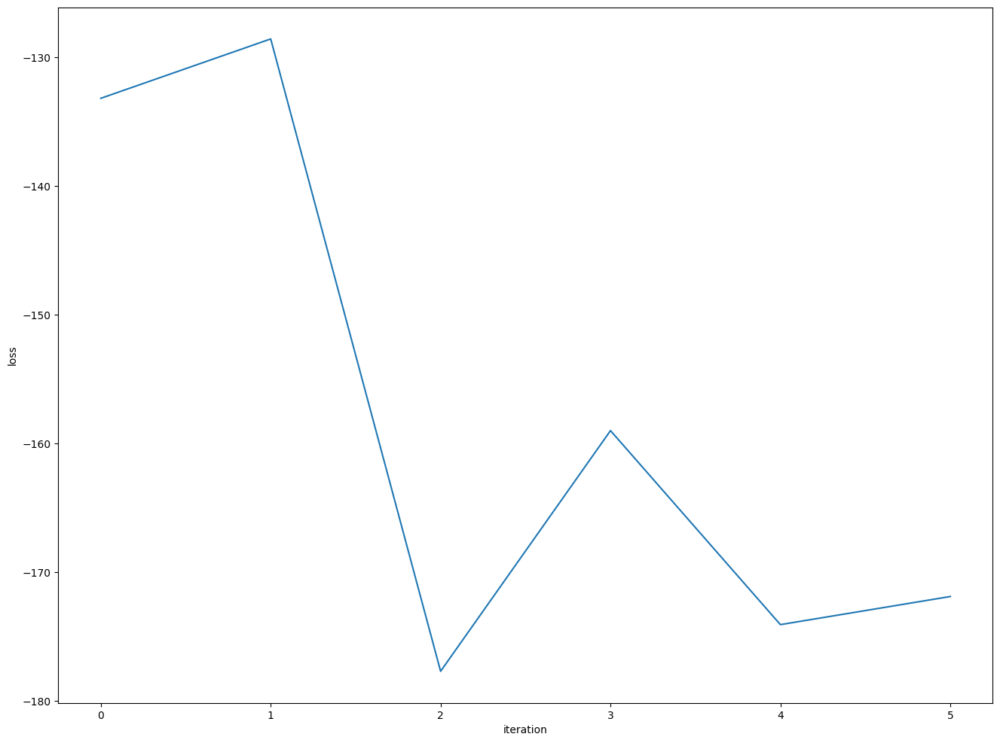

In [73]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")